# Data-driven prediction of battery cycle life before capacity degradation

_Zoé Marquis & Charlotte Kruzic_

## 1. Introduction 
### Présentation du contexte 

- Batteries : 124 cellules lithium-ion testées jusqu'à leur défaillance
- Batches : Trois groupes distincts de données avec des spécificités propres

Une fois qu'on a chargé les données, on va pouvoir un peu mieux les comprendre et ainsi les "reconstruire" dans un dataframe utilisable pour l'apprentissage.

In [1]:
# import

from category_encoders.binary import BinaryEncoder

from dtaidistance.dtw import distance_matrix_fast
from dtaidistance.dtw_barycenter import dba

import matplotlib.pyplot as plt

import numpy as np
np.random.seed(42)


import pandas as pd
import pickle
import plotly.express as px

import random
random.seed(42)
import re

from scipy.signal import savgol_filter

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler




## 2. Exploration des données
### Chargement et description des données


On a vu que certaines batteries étaient réutilisés du batch 1 au batch 2.
Pour pouvoir joindre les données on avait besoin de `barcode` et `channel_id`
# TODO : citer la documentation

On a modifié le code en MatLab pour récupérer `barcode` et `channel_id` 
cf. le fichier `script_barcode_channel_id.m`

Mais on s'est rendu compte que les données correspondants à ces batterices (communes aux batch 1 et 2) étaient supprimés dans le fichier fourni `Load Data.ipynb` (comme commenté dans la cellule suivante).
On a donc pris la décision de laisser les choses comme elles étaient, et on ne récupère donc pas ces données.

Nous n'aurons donc pas de problème d'identification de ces batteries et de recalcul de SOH plus loin dans le code.

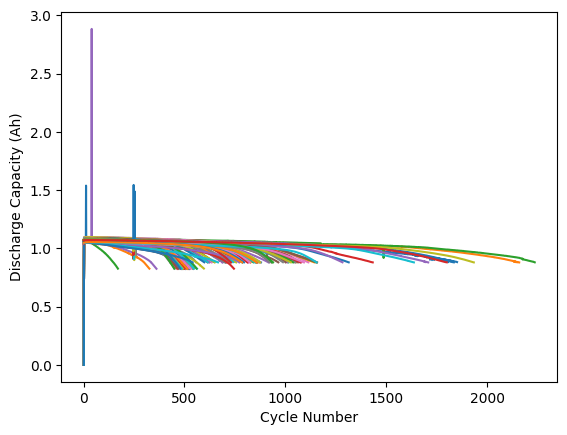

In [2]:
# Chargement des données : basées sur Load Data.ipynb

batch1 = pickle.load(open(r'./Data/batch1.pkl', 'rb'))
#remove batteries that do not reach 80% capacity
del batch1['b1c8']
del batch1['b1c10']
del batch1['b1c12']
del batch1['b1c13']
del batch1['b1c22']
numBat1 = len(batch1.keys())

batch2 = pickle.load(open(r'./Data/batch2.pkl','rb'))
batch2_keys = ['b2c7', 'b2c8', 'b2c9', 'b2c15', 'b2c16']
batch1_keys = ['b1c0', 'b1c1', 'b1c2', 'b1c3', 'b1c4']
add_len = [662, 981, 1060, 208, 482];
for i, bk in enumerate(batch1_keys):
    batch1[bk]['cycle_life'] = batch1[bk]['cycle_life'] + add_len[i]
    for j in batch1[bk]['summary'].keys():
        if j == 'cycle':
            batch1[bk]['summary'][j] = np.hstack((batch1[bk]['summary'][j], batch2[batch2_keys[i]]['summary'][j] + len(batch1[bk]['summary'][j])))
        else:
            batch1[bk]['summary'][j] = np.hstack((batch1[bk]['summary'][j], batch2[batch2_keys[i]]['summary'][j]))
    last_cycle = len(batch1[bk]['cycles'].keys())
    for j, jk in enumerate(batch2[batch2_keys[i]]['cycles'].keys()):
        batch1[bk]['cycles'][str(last_cycle + j)] = batch2[batch2_keys[i]]['cycles'][jk]
del batch2['b2c7'] # c'est batch 2 channel 1 (suite de batch 1 channel 1)
del batch2['b2c8'] # c'est batch 2 channel 2 (suite de batch 1 channel 2)
del batch2['b2c9'] # c'est batch 2 channel 3 (suite de batch 1 channel 3)
del batch2['b2c15'] # c'est batch 2 channel 5 (suite de batch 1 channel 5)
del batch2['b2c16'] # c'est batch 2 channel 6 (suite de batch 1 channel 6)
# Pour l'instant on laisse comme à l'origine, on ne prend pas en compte les données de ce batch qui sont la suite de batch1
numBat2 = len(batch2.keys())

batch3 = pickle.load(open(r'./Data/batch3.pkl','rb'))
# remove noisy channels from batch3
del batch3['b3c37']
del batch3['b3c2']
del batch3['b3c23']
del batch3['b3c32']
del batch3['b3c42']
del batch3['b3c43']
numBat3 = len(batch3.keys())

numBat = numBat1 + numBat2 + numBat3
bat_dict = {**batch1, **batch2, **batch3}
for i in bat_dict.keys():
    plt.plot(bat_dict[i]['summary']['cycle'], bat_dict[i]['summary']['QD'])
plt.xlabel('Cycle Number')
plt.ylabel('Discharge Capacity (Ah)')

test_ind = np.hstack((np.arange(0,(numBat1+numBat2),2),83))
train_ind = np.arange(1,(numBat1+numBat2-1),2)
secondary_test_ind = np.arange(numBat-numBat3,numBat);

In [3]:
# Quelles sont les clefs associées à chaque batterie ?
for bat_id, battery in bat_dict.items():
    print(battery.keys())
    break

dict_keys(['cycle_life', 'charge_policy', 'summary', 'cycles', 'barcode', 'channel_id'])


In [4]:
# Combien de batterie y a-t-il dans les 3 batchs réunis ?
print(f'bat_dict len: {len(bat_dict)}\n')
k1, v1 = list(bat_dict.items())[0]
print(f'k1: {k1}\n')
# Pour chaque batterie, on a les informations suivantes (et les types associés):
for k2, v2 in v1.items():
    print(f'k2: {k2}')
    print(f'v2 type: {type(v2)}')
    print()

bat_dict len: 124

k1: b1c0

k2: cycle_life
v2 type: <class 'numpy.ndarray'>

k2: charge_policy
v2 type: <class 'str'>

k2: summary
v2 type: <class 'dict'>

k2: cycles
v2 type: <class 'dict'>

k2: barcode
v2 type: <class 'numpy.ndarray'>

k2: channel_id
v2 type: <class 'numpy.ndarray'>



In [5]:
# Regardons le contenu de la première batterie
for bat_id, battery in bat_dict.items():
    print(f"Battery ID: {bat_id}") # identifiant
    print(f"Summary: {battery['summary']}") # résumé : un dictionnaire contenant des listes de même taille
    print(f"Cycle Life: {battery['cycle_life']}") # nombre de cycle de vie (+1 ici d'après nos observations)
    print(f"Cycles (len): {len(battery['cycles'])}") # Trop de données pour afficher
    print(f"Charge Policy: {battery['charge_policy']}") # politique de charge : C1(Q1)-C2
    print(f"Barcode: {battery['barcode']}") # code barre
    print(f"Channel ID: {battery['channel_id']}") # identifiant de canal
    break


Battery ID: b1c0
Summary: {'IR': array([0.        , 0.01674235, 0.01672431, ..., 0.0181332 , 0.0181233 ,
       0.0181211 ]), 'QC': array([0.        , 1.0710422 , 1.0716741 , ..., 0.88449496, 0.88432896,
       0.8840425 ]), 'QD': array([0.        , 1.0706892 , 1.0719005 , ..., 0.88462406, 0.88433141,
       0.88280821]), 'Tavg': array([ 0.        , 31.87501078, 31.93149033, ..., 32.70054223,
       32.99059246, 32.96182749]), 'Tmin': array([ 0.      , 29.56613 , 29.604385, ..., 30.243074, 30.337559,
       30.634762]), 'Tmax': array([ 0.      , 35.652016, 35.692978, ..., 36.786781, 36.923153,
       36.535774]), 'chargetime': array([ 0.        , 13.34125   , 13.42577667, ..., 17.04515833,
       17.15257333, 17.35889667]), 'cycle': array([1.000e+00, 2.000e+00, 3.000e+00, ..., 1.849e+03, 1.850e+03,
       1.851e+03])}
Cycle Life: [[1852.]]
Cycles (len): 1851
Charge Policy: 3.6C(80%)-3.6C
Barcode: [[460514]]
Channel ID: [[1]]


In [6]:
# Vérifier que toutes les batteries ont les mêmes clés pour les champs summary et cycles

# Prendre la première batterie comme référence
reference_summary_keys = set(next(iter(bat_dict.values()))["summary"].keys())
reference_cycles_keys = set(next(iter(next(iter(bat_dict.values()))["cycles"].values())).keys())

# Vérifier les clés de chaque batterie
for bat_id, battery in bat_dict.items():
    # Vérification des clés de summary
    summary_keys = set(battery["summary"].keys())
    if summary_keys != reference_summary_keys:
        print(f"Mismatch in summary keys for battery {bat_id}")
        print(f"Expected keys: {reference_summary_keys}")
        print(f"Found keys: {summary_keys}")
    
    # Vérification des clés des cycles
    for cycle_id, cycle_data in battery["cycles"].items():
        cycle_keys = set(cycle_data.keys())
        if cycle_keys != reference_cycles_keys:
            print(f"Mismatch in cycle keys for battery {bat_id}, cycle {cycle_id}")
            print(f"Expected keys: {reference_cycles_keys}")
            print(f"Found keys: {cycle_keys}")

In [7]:
# Vérifier que les champs 'cycles' et cycles de summary (['summary']['cycle']) ont la même longueur pour chaque batterie
for bat_id, battery in bat_dict.items():
    if len(battery['summary']['cycle']) != len(battery['cycles']):
        print(f"Summary length mismatch for battery {bat_id}")

In [8]:
# Quelle est la différence entre 'cycle_life' et la longueur de 'summary' ?
for bat_id, battery in bat_dict.items():
    print(f"{battery['cycle_life'] - len(battery['summary']['cycle'])}")

[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[-26.]]
[[-22.]]
[[-26.]]
[[-26.]]
[[-27.]]
[[-27.]]
[[-34.]]
[[-35.]]
[[-28.]]
[[-33.]]
[[-37.]]
[[-24.]]
[[-31.]]
[[-36.]]
[[-28.]]
[[-29.]]
[[-31.]]
[[-27.]]
[[-35.]]
[[-29.]]
[[-26.]]
[[-27.]]
[[-27.]]
[[-32.]]
[[-24.]]
[[-26.]]
[[-27.]]
[[-25.]]
[[-26.]]
[[-27.]]
[[-23.]]
[[-25.]]
[[-24.]]
[[-22.]]
[[-21.]]
[[-31.]]
[[-23.]]
[[-26.]]
[[-25.]]
[[-22.]]
[[-27.]]
[[-20.]]
[[-32.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]
[[1.]]


On observe une différence de 1 dans la majorité des cas, mais aussi plusieurs valeurs négatives.

Intéressons nous à quel batch il s'agit.

In [9]:
# batch 1
for bat_id, battery in batch1.items():
    diff = battery['cycle_life'] - len(battery['summary']['cycle'])
    if diff != 1:
        print(f"{bat_id}: {diff}")

In [10]:
# batch 2
for bat_id, battery in batch2.items():
    diff = battery['cycle_life'] - len(battery['summary']['cycle'])
    if diff != 1:
        print(f"{bat_id}: {diff}")

b2c0: [[-26.]]
b2c1: [[-22.]]
b2c2: [[-26.]]
b2c3: [[-26.]]
b2c4: [[-27.]]
b2c5: [[-27.]]
b2c6: [[-34.]]
b2c10: [[-35.]]
b2c11: [[-28.]]
b2c12: [[-33.]]
b2c13: [[-37.]]
b2c14: [[-24.]]
b2c17: [[-31.]]
b2c18: [[-36.]]
b2c19: [[-28.]]
b2c20: [[-29.]]
b2c21: [[-31.]]
b2c22: [[-27.]]
b2c23: [[-35.]]
b2c24: [[-29.]]
b2c25: [[-26.]]
b2c26: [[-27.]]
b2c27: [[-27.]]
b2c28: [[-32.]]
b2c29: [[-24.]]
b2c30: [[-26.]]
b2c31: [[-27.]]
b2c32: [[-25.]]
b2c33: [[-26.]]
b2c34: [[-27.]]
b2c35: [[-23.]]
b2c36: [[-25.]]
b2c37: [[-24.]]
b2c38: [[-22.]]
b2c39: [[-21.]]
b2c40: [[-31.]]
b2c41: [[-23.]]
b2c42: [[-26.]]
b2c43: [[-25.]]
b2c44: [[-22.]]
b2c45: [[-27.]]
b2c46: [[-20.]]
b2c47: [[-32.]]


In [11]:
# batch 3
for bat_id, battery in batch3.items():
    diff = battery['cycle_life'] - len(battery['summary']['cycle'])
    if diff != 1:
        print(f"{bat_id}: {diff}")

La différence de 1 on l'explique par la documentation :
> "Cycle 1 data is not available in the struct. The sampling rate for this cycle was initially too high, so we excluded it from the data set to create more manageable file sizes."

Nous n'avons pas trouvé dans la documentation d'explication à la différence pour le batch 2.

# TODO : est ce que ducoup on corrige la valeur pour que ça corresponde ? c'est le cycle_life qui contient moins de données que les données qu'on a dans summary (len cycle ... mais aussi des autres listes (on a bien vérifié que toutes les listes dans summary avaient la meme taille ))

### Description des données : 

####  Description
- charge policy : C1(Q1)-C2
- cycle life : [[int]]
- barcode : [[int]] (on a transformé le string en int en extrayant le sufficxe du barcode en MatLab)
- channel_id : [[int]] (idem)
- summary : dict 
- cycles  : 
    
#### Summary
- basée sur données par cycle (des listes donc)
- le numéro de cycle 
- discharge capacity
- charge capacity
- internal resistance
- maximum temperature
- average temperature
- minimum temperature
- chargetime

#### Cycle 
- infos dans un cycle
    - time
    - charge capacity
    - current
    - voltage
    - temperature
    - discharge capacity

Nous avons essayé d'exploiter les données dans cycle, mais la structure 
# TODO décrire la structure de cycle ici
complexe et trop lourde ne rendait pas notre étude exploitable.
Nous avons donc décidé d'exploiter les données de summary.

### Calcul du SOH : 
On doit intégrer le SOH donné par l'énoncé : 
Q actuelle / Q nominale * 100 # TODO mettre cette formule en forme en markdown

Nous avons du donc commencer par comprendre "qui" sont ces Q.
Nous pensons qu'i s'agit de la "discharge capacity" (QD dans summary).
Q nominale c'est donc la première valeur de "discharge capacity".

(TODO peut etre : on peut se baser sur l'article pour expliciter SOH et SOC)

#### Prochaines étapes 
On va d'abord construire un dataframe puis on ajoutera les champs calculés et enfin supprimer les colonnes alors inutiles.

##### Exploration des données des batch 

In [12]:
# Y a t il des clefs communes entre les différents batchs ?
batch1_keys = set(batch1.keys())
batch2_keys = set(batch2.keys())
batch3_keys = set(batch3.keys())
common_keys = batch1_keys.intersection(batch2_keys).intersection(batch3_keys)
print(f"Common keys: {common_keys}")

Common keys: set()


In [13]:
# Vérifier que toutes les données de summary ont la même longueur
for bat_id, battery in bat_dict.items():
    for key, value in battery['summary'].items():
        if len(value) != len(battery['cycles']):
            print(f"Summary data length mismatch for battery {bat_id}, key {key}")

In [14]:
# Quelle est la longueur de chaque batch ?
print(f'Len batch1: {len(batch1)}')
print(f'Len batch2: {len(batch2)}')
print(f'Len batch3: {len(batch3)}')

Len batch1: 41
Len batch2: 43
Len batch3: 40


In [15]:
# De quoi est composé le champ 'summary' ?
for bat_id, battery in bat_dict.items():
    for k,v in battery['summary'].items():
        print(f"{k}: {v}")
    break

IR: [0.         0.01674235 0.01672431 ... 0.0181332  0.0181233  0.0181211 ]
QC: [0.         1.0710422  1.0716741  ... 0.88449496 0.88432896 0.8840425 ]
QD: [0.         1.0706892  1.0719005  ... 0.88462406 0.88433141 0.88280821]
Tavg: [ 0.         31.87501078 31.93149033 ... 32.70054223 32.99059246
 32.96182749]
Tmin: [ 0.       29.56613  29.604385 ... 30.243074 30.337559 30.634762]
Tmax: [ 0.       35.652016 35.692978 ... 36.786781 36.923153 36.535774]
chargetime: [ 0.         13.34125    13.42577667 ... 17.04515833 17.15257333
 17.35889667]
cycle: [1.000e+00 2.000e+00 3.000e+00 ... 1.849e+03 1.850e+03 1.851e+03]


In [16]:
# Quelles sont les clefs et types de summary ?
for bat_id, battery in bat_dict.items():
    for k,v in battery['summary'].items():
        print(f"{k} \t :: len = {len(v)}, type = {type(v)}, array type = {v.dtype}")
    break

IR 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64
QC 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64
QD 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64
Tavg 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64
Tmin 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64
Tmax 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64
chargetime 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64
cycle 	 :: len = 1851, type = <class 'numpy.ndarray'>, array type = float64


#### Summary  
- le numéro de cycle (indicateur de l'ordre dans notre série temporelle) : `cycle`  
- discharge capacity : `QD`  
- charge capacity : `QC`  
- internal resistance : `IR`  
- maximum temperature : `Tmax`  
- average temperature : `Tavg`  
- minimum temperature : `Tmin`  
- chargetime : `chargetime`  

## TODO ici y a le schéma de données de cycle pour expliciter plus haut : (j'ai pas supprimé les cellules)

In [17]:
# Quelles sont les clefs de cycles ?
for bat_id, battery in bat_dict.items():
    for k,v in battery['cycles'].items():
        print(f"{k} \t :: len = {len(v)}, type = {type(v)}")
    break

0 	 :: len = 9, type = <class 'dict'>
1 	 :: len = 9, type = <class 'dict'>
2 	 :: len = 9, type = <class 'dict'>
3 	 :: len = 9, type = <class 'dict'>
4 	 :: len = 9, type = <class 'dict'>
5 	 :: len = 9, type = <class 'dict'>
6 	 :: len = 9, type = <class 'dict'>
7 	 :: len = 9, type = <class 'dict'>
8 	 :: len = 9, type = <class 'dict'>
9 	 :: len = 9, type = <class 'dict'>
10 	 :: len = 9, type = <class 'dict'>
11 	 :: len = 9, type = <class 'dict'>
12 	 :: len = 9, type = <class 'dict'>
13 	 :: len = 9, type = <class 'dict'>
14 	 :: len = 9, type = <class 'dict'>
15 	 :: len = 9, type = <class 'dict'>
16 	 :: len = 9, type = <class 'dict'>
17 	 :: len = 9, type = <class 'dict'>
18 	 :: len = 9, type = <class 'dict'>
19 	 :: len = 9, type = <class 'dict'>
20 	 :: len = 9, type = <class 'dict'>
21 	 :: len = 9, type = <class 'dict'>
22 	 :: len = 9, type = <class 'dict'>
23 	 :: len = 9, type = <class 'dict'>
24 	 :: len = 9, type = <class 'dict'>
25 	 :: len = 9, type = <class 'dic

In [18]:
stop = False
i = 1
for bat_id, battery in bat_dict.items():
    if not stop:
        print(f"Inspecting battery {bat_id}")
        i2 = 1
        for k,v in battery['cycles'].items():
            if i2 <= 4:
                print(f"{k} \t :: len = {len(v)}, type = {type(v)}")
                for k2, v2 in v.items():
                    print(f"\t{k2} \t :: len = {len(v2)}")
                    # print(f"\t{k2} \t :: len = {len(v2)}, type = {type(v2)} \t\t{v2}")
                i2 += 1
            else:
                break
        if i >= 4 : 
            stop = True
        i += 1
    # break

Inspecting battery b1c0
0 	 :: len = 9, type = <class 'dict'>
	I 	 :: len = 2
	Qc 	 :: len = 2
	Qd 	 :: len = 2
	Qdlin 	 :: len = 2
	T 	 :: len = 2
	Tdlin 	 :: len = 2
	V 	 :: len = 2
	dQdV 	 :: len = 2
	t 	 :: len = 2
1 	 :: len = 9, type = <class 'dict'>
	I 	 :: len = 1087
	Qc 	 :: len = 1087
	Qd 	 :: len = 1087
	Qdlin 	 :: len = 1000
	T 	 :: len = 1087
	Tdlin 	 :: len = 1000
	V 	 :: len = 1087
	dQdV 	 :: len = 1000
	t 	 :: len = 1087
2 	 :: len = 9, type = <class 'dict'>
	I 	 :: len = 1117
	Qc 	 :: len = 1117
	Qd 	 :: len = 1117
	Qdlin 	 :: len = 1000
	T 	 :: len = 1117
	Tdlin 	 :: len = 1000
	V 	 :: len = 1117
	dQdV 	 :: len = 1000
	t 	 :: len = 1117
3 	 :: len = 9, type = <class 'dict'>
	I 	 :: len = 1114
	Qc 	 :: len = 1114
	Qd 	 :: len = 1114
	Qdlin 	 :: len = 1000
	T 	 :: len = 1114
	Tdlin 	 :: len = 1000
	V 	 :: len = 1114
	dQdV 	 :: len = 1000
	t 	 :: len = 1114
Inspecting battery b1c1
0 	 :: len = 9, type = <class 'dict'>
	I 	 :: len = 2
	Qc 	 :: len = 2
	Qd 	 :: len = 2
	Qd

## FIN CYCLES PAS COMPRIS

##### Exploration des données dans summary 

In [19]:
# Est ce que la liste de cycle_life est toujours de longueur 1 ?
for bat_id, battery in bat_dict.items():
    if len(battery['cycle_life']) != 1:
        print(f"{bat_id}: {len(battery['cycle_life'])}")

In [20]:
# Remplacer la liste par juste la valeur de cycle_life (supprimer le ndarray de taille 1)
for bat_id, battery in bat_dict.items():
    battery['cycle_life'] = battery['cycle_life'][0][0]

In [21]:
# Vérifier que c'est bien maintenant un float
for bat_id, battery in bat_dict.items():
    if type(battery['cycle_life']) != np.float64:
        print(f"{bat_id}: {type(battery['cycle_life'])}")

In [22]:
# Vérifier que ce sont bien des ints cachés derrire les floats
for bat_id, battery in bat_dict.items():
    if battery['cycle_life'] != int(battery['cycle_life']):
        print(f"{bat_id}: {battery['cycle_life']}")

In [23]:
# Caster les cycle_life en int
for bat_id, battery in bat_dict.items():
    battery['cycle_life'] = int(battery['cycle_life'])

# Vérifier que ce sont bien des int maintenant
for bat_id, battery in bat_dict.items():
    if type(battery['cycle_life']) != int:
        print(f"{bat_id}: {type(battery['cycle_life'])}")

In [24]:
# Remplacer les listes de barcode et channel_id par leur valeur
for bat_id, battery in bat_dict.items():
    battery['barcode'] = battery['barcode'][0][0]
    battery['channel_id'] = battery['channel_id'][0][0]

# Vérifier que ce sont bien des int maintenant
for bat_id, battery in bat_dict.items():
    if type(battery['barcode']) != np.int64:
        print(f"{bat_id}: {type(battery['barcode'])}")
    if type(battery['channel_id']) != np.int32:
        print(f"{bat_id}: {type(battery['channel_id'])}")

# Caster les barcode et channel_id en int
for bat_id, battery in bat_dict.items():
    battery['barcode'] = int(battery['barcode'])
    battery['channel_id'] = int(battery['channel_id'])

# Vérifier que ce sont bien des int maintenant
for bat_id, battery in bat_dict.items():
    if type(battery['barcode']) != int:
        print(f"{bat_id}: {type(battery['barcode'])}")
    if type(battery['channel_id']) != int:
        print(f"{bat_id}: {type(battery['channel_id'])}")

In [25]:
# Vérifier la structure de chaque batterie (type, clef des sous dict...)
for bat_id, battery in bat_dict.items():
    # Vérifier que les clés attendues existent
    if 'summary' not in battery or 'cycle_life' not in battery or 'cycles' not in battery or 'charge_policy' not in battery:
        print(f"Missing key in battery {bat_id}")

    # Vérifier que les clés de summary sont bien présentes
    for k in ['IR', 'QC', 'QD', 'Tavg', 'Tmin', 'Tmax', 'chargetime', 'cycle']:
        if k not in battery['summary']:
            print(f"Missing key {k} in summary of battery {bat_id}")

    # Vérifier le format de cycle life
    if type(battery['cycle_life']) != int:
        print(f"Unexpected format for cycle_life in battery {bat_id}, type : {type(battery['cycle_life'])}")

    # Vérifier le type de charge policy
    if type(battery['charge_policy']) != str:
        print(f"Charge policy is not a string in battery {bat_id}")

In [26]:
# Vérifier que pour chaque ['summary']['cycle'] la liste est bien toujours un range de 1 à n (et +1 entre chaque cycle)
for bat_id, battery in bat_dict.items():
    cycle_range = range(1, len(battery['summary']['cycle'])+1)
    if not np.array_equal(battery['summary']['cycle'], np.array(cycle_range)):
        print(f"Cycle range mismatch for battery {bat_id}")

### Chevauchement entre batch 1 et 2 

> 3.6C(80%) and 4C(80%) policies have data that carry over from batch 1 (link on barcode). This applies to the cells in channels 1, 2, 3, 5, and 6. Please note that these are NOT new experiments, but a continuation of experiments from the 2017-05-12 batch.

> The cells in Channels 1, 2, 3, 5, and 6 (3.6C(80%) and 4C(80%) policies) were stopped at the end of this batch and resumed in the 2017-06-30 batch. This pause in cycling lead to a rise in capacity upon resuming the tests.

Après une étude un peu plus longue, récupération des barcode et des channel id, on s'est rendu compte que par défaut dans le `Load Data` du repo associé au projet, ces données étaient supprimées.  
On considère donc la suite sans prendre en compte cela (on n'a donc pas de données suite des autres à étudier différemment)

### Former un Dataframe

In [27]:
df = pd.DataFrame(bat_dict)
df = df.transpose() # Transpose pour avoir les batteries en index
df = df.reset_index() 
df = df.rename(columns={'index': 'battery_id'})
df.head()

,battery_id,cycle_life,charge_policy,summary,cycles,barcode,channel_id
0,b1c0,1852,3.6C(80%)-3.6C,"{'IR': [0.0, 0.016742354, 0.016724309, 0.01668...","{'0': {'I': [0, 0], 'Qc': [0, 0], 'Qd': [0, 0]...",460514,1
1,b1c1,2160,3.6C(80%)-3.6C,"{'IR': [0.0, 0.017038831, 0.017009802, 0.01692...","{'0': {'I': [0, 0], 'Qc': [0, 0], 'Qd': [0, 0]...",460486,2
2,b1c2,2237,3.6C(80%)-3.6C,"{'IR': [0.0, 0.01686798, 0.016831938, 0.016718...","{'0': {'I': [0, 0], 'Qc': [0, 0], 'Qd': [0, 0]...",460623,3
3,b1c3,1434,4C(80%)-4C,"{'IR': [0.0, 0.016369704, 0.016315572, 0.01632...","{'0': {'I': [0, 0], 'Qc': [0, 0], 'Qd': [0, 0]...",464977,5
4,b1c4,1709,4C(80%)-4C,"{'IR': [0.0, 0.016787428, 0.016740341, 0.01673...","{'0': {'I': [0, 0], 'Qc': [0, 0], 'Qd': [0, 0]...",464865,6


In [28]:
# Supprimer cycles
df.drop(columns=['cycles'], inplace=True)
df.head()

,battery_id,cycle_life,charge_policy,summary,barcode,channel_id
0,b1c0,1852,3.6C(80%)-3.6C,"{'IR': [0.0, 0.016742354, 0.016724309, 0.01668...",460514,1
1,b1c1,2160,3.6C(80%)-3.6C,"{'IR': [0.0, 0.017038831, 0.017009802, 0.01692...",460486,2
2,b1c2,2237,3.6C(80%)-3.6C,"{'IR': [0.0, 0.01686798, 0.016831938, 0.016718...",460623,3
3,b1c3,1434,4C(80%)-4C,"{'IR': [0.0, 0.016369704, 0.016315572, 0.01632...",464977,5
4,b1c4,1709,4C(80%)-4C,"{'IR': [0.0, 0.016787428, 0.016740341, 0.01673...",464865,6


In [29]:
# Extraire C1(Q1)-C2 pour chaque charge_policy et ajouter les colonnes dans le dataframe
# si ça matche pas -> print

pattern = r"(?P<C1>[0-9.]+)C\((?P<Q1>[0-9]+)%\)-(?P<C2>[0-9.]+)C?"

def extract_c1_q1_c2(row):
    match = re.match(pattern, row)
    if match:
        return match.group('C1'), match.group('Q1'), match.group('C2')
    else:
        print(row)
        return None, None, None
    
df[['C1', 'Q1', 'C2']] = df['charge_policy'].apply(extract_c1_q1_c2).apply(pd.Series)

mismatches = df[df['C1'].isna()]
print(f'Mismatches: {mismatches}')

Mismatches: Empty DataFrame
Columns: [battery_id, cycle_life, charge_policy, summary, barcode, channel_id, C1, Q1, C2]
Index: []


In [30]:
df[['C1', 'Q1', 'C2', 'charge_policy']].head()

,C1,Q1,C2,charge_policy
0,3.6,80,3.6,3.6C(80%)-3.6C
1,3.6,80,3.6,3.6C(80%)-3.6C
2,3.6,80,3.6,3.6C(80%)-3.6C
3,4,80,4,4C(80%)-4C
4,4,80,4,4C(80%)-4C


In [31]:
df['C1'].unique() # TODO : est ce que y a des valeurs min max ? doc à voir

array(['3.6', '4', '4.4', '4.8', '5.4', '6', '7', '8', '1', '2', '4.65',
       '4.9', '5.2', '5.6', '5', '5.3', '3.7', '5.9'], dtype=object)

In [32]:
df['C2'].unique() # TODO : eest ce que y a des valeurs min max ? doc à voir

array(['3.6', '4', '4.4', '4.8', '3', '5.4', '6', '5', '5.5', '4.85',
       '4.75', '4.5', '4.25', '3.5', '4.3', '4.6', '5.9', '3.1'],
      dtype=object)

In [33]:
df['Q1'].unique() # TODO : doc à voir si données bien dans les limites attendues

array(['80', '40', '50', '60', '70', '30', '15', '25', '35', '4', '10',
       '2', '7', '22', '9', '13', '31', '24', '47', '55', '8', '19', '44',
       '69', '27', '61', '37', '58', '66', '71', '38', '5', '65', '20',
       '52', '67', '54', '36'], dtype=object)

In [34]:
# Supprimer la colonne charge_policy maintenant qu'on a extrait les informations
df = df.drop(columns=['charge_policy'])

In [35]:
# Convertir C1 et C2 en float et Q1 en int
df['C1'] = df['C1'].astype(float)
df['C2'] = df['C2'].astype(float)
df['Q1'] = df['Q1'].astype(int)

In [36]:
# Extraire la provenance du batch (pour par la suite pouvoir ajouter les données de la documentation)

# battery_id = 'b1c0' (batch 1 , cell 0)
pattern = r"b(?P<batch>[0-9]+)c(?P<cell>[0-9]+)"

def extract_batch_cell_ids(row):
    match = re.match(pattern, row)
    if match:
        return match.group('batch'), match.group('cell')
    else:
        print(row)
        return None, None
    
df[['batch', 'cell']] = df['battery_id'].apply(extract_batch_cell_ids).apply(pd.Series)

mismatches = df[df['batch'].isna()]
print(f'Mismatches: {mismatches}')

Mismatches: Empty DataFrame
Columns: [battery_id, cycle_life, summary, barcode, channel_id, C1, Q1, C2, batch, cell]
Index: []


In [37]:
df['batch'].unique()

array(['1', '2', '3'], dtype=object)

In [38]:
df['batch'] = df['batch'].astype(int)
df['batch'].unique()

array([1, 2, 3])

In [39]:
df['cell'].unique()

array(['0', '1', '2', '3', '4', '5', '6', '7', '9', '11', '14', '15',
       '16', '17', '18', '19', '20', '21', '23', '24', '25', '26', '27',
       '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38',
       '39', '40', '41', '42', '43', '44', '45', '10', '12', '13', '22',
       '46', '47', '8'], dtype=object)

In [40]:
df = df.drop(columns=['battery_id'])
df = df.drop(columns=['cell'])

In [41]:
df.head()

,cycle_life,summary,barcode,channel_id,C1,Q1,C2,batch
0,1852,"{'IR': [0.0, 0.016742354, 0.016724309, 0.01668...",460514,1,3.6,80,3.6,1
1,2160,"{'IR': [0.0, 0.017038831, 0.017009802, 0.01692...",460486,2,3.6,80,3.6,1
2,2237,"{'IR': [0.0, 0.01686798, 0.016831938, 0.016718...",460623,3,3.6,80,3.6,1
3,1434,"{'IR': [0.0, 0.016369704, 0.016315572, 0.01632...",464977,5,4.0,80,4.0,1
4,1709,"{'IR': [0.0, 0.016787428, 0.016740341, 0.01673...",464865,6,4.0,80,4.0,1


In [42]:
# Types des données du dataframe
df.dtypes

cycle_life     object
summary        object
barcode        object
channel_id     object
C1            float64
Q1              int64
C2            float64
batch           int64
dtype: object

In [43]:
# cycle_life -> int
df['cycle_life'] = df['cycle_life'].astype(int)

On doit extraire Qnominale

In [44]:
# Extraire le Qnominale : prendre le [summary][QD][0]
df['QD1'] = df['summary'].apply(lambda x: x['QD'][0])

In [45]:
df['QD1'].unique()

array([0.       , 1.0680572, 1.06918  , 1.0708591, 1.0638535, 1.0692153,
       1.0641999, 1.0651802, 1.0651031, 1.0680432, 1.0676208, 1.076097 ,
       1.0742625, 1.0648884, 1.0610169, 1.0454259, 1.0786781, 1.0718927,
       1.0757267, 1.0713947, 1.0639789, 1.0640887, 1.0733846, 1.0623763,
       1.0682162, 1.0699197, 1.0634685, 1.0695118, 1.0712117, 1.0758885,
       1.0649502, 1.0651143, 1.0753652, 1.0712371, 1.0661006, 1.0743777,
       1.0735563, 1.0648384, 1.074605 , 1.0691837, 1.0664769, 1.0661633,
       1.0683196, 1.0383378, 1.0665728, 1.0642239, 1.0622736, 1.0717411,
       1.0500579, 1.0620248, 1.0664694, 1.0636606, 1.0683683, 1.0608749,
       1.0673251, 1.0731678, 1.0642039, 1.0716274, 1.0677625, 1.0605524,
       1.0653081, 1.0674672, 1.0706265, 1.063777 , 1.0678786, 1.0551282,
       1.0451531, 1.0600799, 1.0709693, 1.0592589, 1.0512739, 1.0652004,
       1.0674757, 1.0674968, 1.0594152, 1.0602307, 1.0626153, 1.0573761,
       1.0691597, 1.0464231, 1.0581568, 1.0491925, 

In [46]:
# On aperçoit un 0 : cela n'est pas normal, on sauve donc aussi le QD2 pour pouvoir le remplacer

In [47]:
df['QD2'] = df['summary'].apply(lambda x: x['QD'][1])
df['QD2'].unique()

array([1.0706892, 1.0753012, 1.0799223, 1.0797229, 1.0784167, 1.0761266,
       1.0758358, 1.0938644, 1.0829742, 1.0537786, 1.0709661, 1.0611236,
       1.0811664, 1.072052 , 1.0661705, 1.0851147, 1.07263  , 1.0824388,
       1.0792934, 1.0745355, 1.0752345, 1.0876514, 1.0790461, 1.0777475,
       1.0794537, 1.0798637, 1.0946392, 1.0778366, 1.0924908, 1.0766174,
       1.0707464, 1.0778315, 1.0748194, 1.0729513, 1.0817773, 1.0833029,
       1.0789614, 1.0798725, 1.0682389, 1.0847682, 1.0839558, 1.0700541,
       1.0720705, 1.0735391, 1.0668509, 1.0728973, 1.0680153, 1.0687391,
       1.0690521, 1.0717047, 1.0712759, 1.080285 , 1.0780684, 1.0656468,
       1.063838 , 1.0480373, 1.0831043, 1.0768799, 1.079723 , 1.0745209,
       1.0679682, 1.0672674, 1.0766411, 1.065841 , 1.07155  , 1.0725043,
       1.0672802, 1.0732793, 1.0742669, 1.079052 , 1.0688509, 1.0687217,
       1.079731 , 1.0748166, 1.0699497, 1.0784613, 1.0765519, 1.0682049,
       1.0780239, 1.0735646, 1.070887 , 1.0704726, 

In [48]:
summary_expanded = df['summary'].apply(pd.Series)
summary_expanded['barcode'] = df['barcode']
summary_expanded['batch'] = df['batch']
summary_expanded['channel_id'] = df['channel_id']
summary_expanded['cycle_life'] = df['cycle_life']
summary_expanded['QD1'] = df['QD1']
summary_expanded['QD2'] = df['QD2']
summary_expanded['C1'] = df['C1']
summary_expanded['Q1'] = df['Q1']
summary_expanded['C2'] = df['C2']
summary_expanded.head()

,IR,QC,QD,Tavg,Tmin,Tmax,chargetime,cycle,barcode,batch,channel_id,cycle_life,QD1,QD2,C1,Q1,C2
0,"[0.0, 0.016742354, 0.016724309, 0.016681245, 0...","[0.0, 1.0710422, 1.0716741, 1.0723044, 1.07297...","[0.0, 1.0706892, 1.0719005, 1.0725095, 1.07317...","[0.0, 31.875010776448963, 31.931490327663376, ...","[0.0, 29.56613, 29.604385, 29.744202, 29.64470...","[0.0, 35.652016, 35.692978, 35.680588, 35.7286...","[0.0, 13.341250000000006, 13.42577666666666, 1...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",460514,1,1,1852,0.0,1.070689,3.6,80,3.6
1,"[0.0, 0.017038831, 0.017009802, 0.016928403, 0...","[0.0, 1.0750588, 1.0764499, 1.0771132, 1.07775...","[0.0, 1.0753012, 1.0766124, 1.0772982, 1.07815...","[0.0, 31.668844081576545, 31.722739939231452, ...","[0.0, 29.853098, 29.857759, 30.133654, 29.9605...","[0.0, 34.307796, 34.418705, 34.707664, 34.5954...","[0.0, 13.426056666666652, 13.341520000000006, ...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",460486,1,2,2160,0.0,1.075301,3.6,80,3.6
2,"[0.0, 0.01686798, 0.016831938, 0.01671898, 0.0...","[0.0, 1.0797698, 1.0811372, 1.0819083, 1.08250...","[0.0, 1.0799223, 1.0813154, 1.082234, 1.082731...","[0.0, 31.82541973754445, 31.875471250889714, 3...","[0.0, 29.983988, 30.001017, 30.300148, 30.0331...","[0.0, 34.703838, 34.788918, 35.098438, 34.9782...","[0.0, 13.34142166666667, 13.341461666666662, 1...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",460623,1,3,2237,0.0,1.079922,3.6,80,3.6
3,"[0.0, 0.016369704, 0.016315572, 0.016325498, 0...","[0.0, 1.0793147, 1.0806946, 1.0815663, 1.08224...","[0.0, 1.0797229, 1.0812283, 1.0819938, 1.08273...","[0.0, 30.245592437098356, 30.313372000000026, ...","[0.0, 29.596653, 29.836266, 29.724728, 29.9965...","[0.0, 30.935932, 31.18433, 30.779972, 31.10115...","[0.0, 12.008575000000018, 12.008094999999988, ...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",464977,1,5,1434,0.0,1.079723,4.0,80,4.0
4,"[0.0, 0.016787428, 0.016740341, 0.016738746, 0...","[0.0, 1.078509, 1.0789363, 1.0796522, 1.080269...","[0.0, 1.0784167, 1.0790124, 1.0797466, 1.08042...","[0.0, 31.659106455331386, 31.682169403151168, ...","[0.0, 29.640825, 29.737724, 29.74818, 29.84008...","[0.0, 34.610603, 34.632095, 34.424313, 34.5436...","[0.0, 12.008310000000014, 12.092648333333333, ...","[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, ...",464865,1,6,1709,0.0,1.078417,4.0,80,4.0


In [49]:
summary_expanded['barcode'].nunique()

124

124 barcode différents, 124 batteries étudiées

In [50]:
# Pivoter les données de summary pour avoir une ligne par cycle
result = summary_expanded.apply(lambda row : pd.DataFrame({
    "barcode": row["barcode"],
    "channel_id": row["channel_id"],
    "batch": row["batch"],

    "cycle_life" : row["cycle_life"],
    "C1": row["C1"],
    "C2": row["C2"],
    "Q1": row["Q1"],

    "QD1": row["QD1"],
    "QD2": row["QD2"],
    
    "cycle" : row["cycle"],
    "IR" : row["IR"],
    "QC" : row["QC"],
    "QD" : row["QD"],
    "Tavg" : row["Tavg"],
    "Tmin" : row["Tmin"],
    "Tmax" : row["Tmax"],
    "chargetime" : row["chargetime"],
}), axis=1)

In [51]:
result[0]

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,QD1,QD2,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime
0,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,2.0,0.016742,1.071042,1.070689,31.875011,29.566130,35.652016,13.341250
2,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,3.0,0.016724,1.071674,1.071900,31.931490,29.604385,35.692978,13.425777
3,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,4.0,0.016681,1.072304,1.072510,31.932603,29.744202,35.680588,13.425167
4,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,5.0,0.016662,1.072970,1.073174,31.959322,29.644709,35.728691,13.341442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1846,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1847.0,0.018263,0.885568,0.885435,32.432079,31.080084,35.415527,17.025530
1847,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1848.0,0.018619,0.884639,0.884546,31.683310,28.951157,36.136974,17.025530
1848,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1849.0,0.018133,0.884495,0.884624,32.700542,30.243074,36.786781,17.045158
1849,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1850.0,0.018123,0.884329,0.884331,32.990592,30.337559,36.923153,17.152573


In [52]:
result[123]

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,QD1,QD2,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime
0,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,1.0,0.015778,1.068454,1.068802,32.615140,30.800251,34.506973,11.037985
1,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,2.0,0.015742,1.069192,1.069549,32.583423,30.786549,34.443512,11.039718
2,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,3.0,0.015712,1.069926,1.070114,32.589319,30.680435,34.548187,11.037380
3,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,4.0,0.015698,1.070196,1.070422,32.572895,30.635644,34.512981,11.037245
4,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,5.0,0.015679,1.070442,1.070618,32.536870,30.620083,34.481216,11.036160
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1795,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,1796.0,0.017538,0.881796,0.881539,32.532753,30.328932,34.571934,15.404138
1796,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,1797.0,0.017294,0.881874,0.881441,32.679857,29.591684,35.492989,15.497987
1797,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,1798.0,0.017605,0.881364,0.880883,32.217071,31.470758,33.999550,16.357937
1798,739484,9,3,1801,4.8,4.8,80,1.068802,1.069549,1799.0,0.017526,0.881120,0.880757,33.035630,29.526152,35.779078,16.046140


In [53]:
# Vérifier que pour chaque élément de result il y a une valeur unique pour tous les éléments de la batterie
for i in range(len(result)):
    df = result[i]
    unique_values = df[['barcode', 'channel_id', 'batch', 'cycle_life', 'C1', 'C2', 'Q1', 'QD1', 'QD2']].nunique()
    if not all(unique_values == 1):
        print(f"Mismatch in element {i}:")
        print(unique_values)

In [54]:
pivot_df = pd.concat(result.values)
pivot_df.head()

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,QD1,QD2,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime
0,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,2.0,0.016742,1.071042,1.070689,31.875011,29.566130,35.652016,13.341250
2,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,3.0,0.016724,1.071674,1.071900,31.931490,29.604385,35.692978,13.425777
3,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,4.0,0.016681,1.072304,1.072510,31.932603,29.744202,35.680588,13.425167
4,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,5.0,0.016662,1.072970,1.073174,31.959322,29.644709,35.728691,13.341442


In [55]:
df = pivot_df

In [56]:
# Extraction de 5 barcode aléatoirement pour chaque batch, ainsi que la valeur min et max de cycle associé au barcode
# (explicaiton à la toute fin du notebook)

# Les mettre dans un dico "dict_explicabilite"
dict_explicabilite = []

# batch 1
batch1_barcodes = df[df['batch'] == 1]['barcode'].unique()
batch1_random_barcodes = random.sample(list(batch1_barcodes), 5)
print(f"Batch 1 random barcodes: {batch1_random_barcodes}")

# batch 2
batch2_barcodes = df[df['batch'] == 2]['barcode'].unique()
batch2_random_barcodes = random.sample(list(batch2_barcodes), 5)
print(f"Batch 2 random barcodes: {batch2_random_barcodes}")

# batch 3
batch3_barcodes = df[df['batch'] == 3]['barcode'].unique()
batch3_random_barcodes = random.sample(list(batch3_barcodes), 5)
print(f"Batch 3 random barcodes: {batch3_random_barcodes}")

# batch 1
for barcode in batch1_random_barcodes:
    min_cycle = df[(df['batch'] == 1) & (df['barcode'] == barcode)]['cycle'].min()
    max_cycle = df[(df['batch'] == 1) & (df['barcode'] == barcode)]['cycle'].max()
    print(f"Barcode {barcode} min cycle: {min_cycle}, max cycle: {max_cycle}")
    dict_explicabilite.append({
        'batch': 1,
        'barcode': barcode,
        'min_cycle': min_cycle,
        'max_cycle': max_cycle
    })

# batch 2
for barcode in batch2_random_barcodes:
    min_cycle = df[(df['batch'] == 2) & (df['barcode'] == barcode)]['cycle'].min()
    max_cycle = df[(df['batch'] == 2) & (df['barcode'] == barcode)]['cycle'].max()
    print(f"Barcode {barcode} min cycle: {min_cycle}, max cycle: {max_cycle}")
    dict_explicabilite.append({
        'batch': 2,
        'barcode': barcode,
        'min_cycle': min_cycle,
        'max_cycle': max_cycle
    })

# batch 3
for barcode in batch3_random_barcodes:
    min_cycle = df[(df['batch'] == 3) & (df['barcode'] == barcode)]['cycle'].min()
    max_cycle = df[(df['batch'] == 3) & (df['barcode'] == barcode)]['cycle'].max()
    print(f"Barcode {barcode} min cycle: {min_cycle}, max cycle: {max_cycle}")
    dict_explicabilite.append({
        'batch': 3,
        'barcode': barcode,
        'min_cycle': min_cycle,
        'max_cycle': max_cycle
    })

Batch 1 random barcodes: [np.int64(460656), np.int64(465027), np.int64(460486), np.int64(463871), np.int64(464881)]
Batch 2 random barcodes: [np.int64(440551), np.int64(460466), np.int64(460634), np.int64(460627), np.int64(460635)]
Batch 3 random barcodes: [np.int64(739495), np.int64(737320), np.int64(737280), np.int64(737313), np.int64(737229)]
Barcode 460656 min cycle: 1.0, max cycle: 598.0
Barcode 465027 min cycle: 1.0, max cycle: 869.0
Barcode 460486 min cycle: 1.0, max cycle: 2159.0
Barcode 463871 min cycle: 1.0, max cycle: 558.0
Barcode 464881 min cycle: 1.0, max cycle: 787.0
Barcode 440551 min cycle: 1.0, max cycle: 489.0
Barcode 460466 min cycle: 1.0, max cycle: 505.0
Barcode 460634 min cycle: 1.0, max cycle: 545.0
Barcode 460627 min cycle: 1.0, max cycle: 480.0
Barcode 460635 min cycle: 1.0, max cycle: 507.0
Barcode 739495 min cycle: 1.0, max cycle: 785.0
Barcode 737320 min cycle: 1.0, max cycle: 857.0
Barcode 737280 min cycle: 1.0, max cycle: 1114.0
Barcode 737313 min cycle: 

In [57]:
# Filtrer les lignes où 'cycle' = 1 pour extraire QD
df_qd1 = df[df['cycle'] == 1][['barcode', 'QD']]
# Renommer la colonne 'QD' en 'QD1bis' pour la joindre plus facilement
df_qd1 = df_qd1.rename(columns={'QD': 'QD1bis'})

# Joindre les DataFrames avec le DataFrame d'origine sur la colonne 'barcode
df = pd.merge(df, df_qd1, on='barcode', how='left')

df.head()


,barcode,channel_id,batch,cycle_life,C1,C2,Q1,QD1,QD2,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime,QD1bis
0,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
1,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,2.0,0.016742,1.071042,1.070689,31.875011,29.566130,35.652016,13.341250,0.0
2,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,3.0,0.016724,1.071674,1.071900,31.931490,29.604385,35.692978,13.425777,0.0
3,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,4.0,0.016681,1.072304,1.072510,31.932603,29.744202,35.680588,13.425167,0.0
4,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,5.0,0.016662,1.072970,1.073174,31.959322,29.644709,35.728691,13.341442,0.0


In [58]:
# Filtrer les lignes où 'cycle' = 2 pour extraire QD
df_qd2 = df[df['cycle'] == 2][['barcode', 'QD']]

# Renommer la colonne 'QD' en 'QD2bis' pour la joindre plus facilement
df_qd2 = df_qd2.rename(columns={'QD': 'QD2bis'})

# Joindre les DataFrames avec le DataFrame d'origine sur la colonne 'barcode'
df = pd.merge(df, df_qd2, on='barcode', how='left')

df.head()

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,QD1,QD2,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime,QD1bis,QD2bis
0,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.070689
1,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,2.0,0.016742,1.071042,1.070689,31.875011,29.566130,35.652016,13.341250,0.0,1.070689
2,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,3.0,0.016724,1.071674,1.071900,31.931490,29.604385,35.692978,13.425777,0.0,1.070689
3,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,4.0,0.016681,1.072304,1.072510,31.932603,29.744202,35.680588,13.425167,0.0,1.070689
4,460514,1,1,1852,3.6,3.6,80,0.0,1.070689,5.0,0.016662,1.072970,1.073174,31.959322,29.644709,35.728691,13.341442,0.0,1.070689


In [59]:
# Vérifier si QD1 et QD1bis sont identiques
identical = (df['QD1'] == df['QD1bis']).all()
print(f"QD1 and QD1bis are identical: {identical}")

QD1 and QD1bis are identical: True


In [60]:
identical = (df['QD2'] == df['QD2bis']).all()
print(f"QD2 and QD2bis are identical: {identical}")

QD2 and QD2bis are identical: True


In [61]:
# On drop donc les "bis" : on a bien reconstruit les colonnes QD1 et QD2
df = df.drop(columns=['QD1bis'])
df = df.drop(columns=['QD2bis'])

In [62]:
# On ne peut pas accepter que Qnominale soit 0

# Vérifions que quand QD1 = 0, cycle = 1 alors IR, QC, QD, Tavg, Tmin, Tmax, chargetime = 0
df[(df['QD1'] == 0) & (df['cycle'] == 1)][['IR', 'QC', 'QD', 'Tavg', 'Tmin', 'Tmax', 'chargetime']].nunique()

IR            1
QC            1
QD            1
Tavg          1
Tmin          1
Tmax          1
chargetime    1
dtype: int64

In [63]:
# Voir les valeurs quand QD1 = 0 et cycle = 1
df[(df['QD1'] == 0) & (df['cycle'] == 1)][['IR', 'QC', 'QD', 'Tavg', 'Tmin', 'Tmax', 'chargetime']].head(1)

,IR,QC,QD,Tavg,Tmin,Tmax,chargetime
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [64]:
# C'est bon tout est à zéro -> on va supprimer ces lignes
df = df.drop(df[(df['QD1'] == 0) & (df['cycle'] == 1)].index)

# Récapitulons : on veut créer la colonne Qnominale
# si QD1 = 0 alors Qnominale = QD2 
# sinon Qnominale = QD1

# On va donc créer une colonne Qnominale
df['Qnominale'] = df['QD1']
df.loc[df['QD1'] == 0, 'Qnominale'] = df['QD2']
df = df.drop(columns=['QD1'])
df = df.drop(columns=['QD2'])

df.head()

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime,Qnominale
1,460514,1,1,1852,3.6,3.6,80,2.0,0.016742,1.071042,1.070689,31.875011,29.566130,35.652016,13.341250,1.070689
2,460514,1,1,1852,3.6,3.6,80,3.0,0.016724,1.071674,1.071900,31.931490,29.604385,35.692978,13.425777,1.070689
3,460514,1,1,1852,3.6,3.6,80,4.0,0.016681,1.072304,1.072510,31.932603,29.744202,35.680588,13.425167,1.070689
4,460514,1,1,1852,3.6,3.6,80,5.0,0.016662,1.072970,1.073174,31.959322,29.644709,35.728691,13.341442,1.070689
5,460514,1,1,1852,3.6,3.6,80,6.0,0.016623,1.073491,1.073576,31.961062,29.752932,35.711758,13.340835,1.070689


In [65]:
# Convertir cycle en int
df['cycle'] = df['cycle'].astype(int)

In [66]:
# On peut donc maintenant calculer le SOH : QD / Qnominale * 100 
df['SOH'] = (df['QD'] / df['Qnominale']) * 100
df.head()

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime,Qnominale,SOH
1,460514,1,1,1852,3.6,3.6,80,2,0.016742,1.071042,1.070689,31.875011,29.566130,35.652016,13.341250,1.070689,100.000000
2,460514,1,1,1852,3.6,3.6,80,3,0.016724,1.071674,1.071900,31.931490,29.604385,35.692978,13.425777,1.070689,100.113133
3,460514,1,1,1852,3.6,3.6,80,4,0.016681,1.072304,1.072510,31.932603,29.744202,35.680588,13.425167,1.070689,100.170012
4,460514,1,1,1852,3.6,3.6,80,5,0.016662,1.072970,1.073174,31.959322,29.644709,35.728691,13.341442,1.070689,100.232075
5,460514,1,1,1852,3.6,3.6,80,6,0.016623,1.073491,1.073576,31.961062,29.752932,35.711758,13.340835,1.070689,100.269630


In [67]:
# Affcher valeurs statistiques liées à SOH
df['SOH'].describe()

count    100460.000000
mean         96.411939
std           4.821813
min          76.646759
25%          94.968482
50%          98.250525
75%          99.803933
max         270.508751
Name: SOH, dtype: float64

#### Visualisation SOH 

In [68]:
# Créer une figure interactive avec Plotly
fig = px.line(
    df,
    x='cycle',
    y='SOH',
    color='barcode',  
    title="Évolution de SOH pour différents ID",
    labels={"cycle": "Cycle", "SOH": "SOH (%)"},
)

# Ajout d'options interactives
fig.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Barcode",
    hovermode="x unified",
)

# Afficher la figure
fig.show()


### Gestion valeurs aberrantes de SOH > 100%

In [69]:
# Quels id sont concernés par un SOH > 100% ?
df[df['SOH'] > 100]['barcode'].unique()

array([460514, 460486, 460623, 464977, 464865, 464883, 463886, 465027,
       460468, 463882, 463838, 453113, 460653, 460522, 453240, 464881,
       464002, 463871, 460477, 460630, 460617, 460659, 463198, 460507,
       460644, 460615, 460481, 460640, 460436, 460525, 460622, 460506,
       460601, 453773, 460642, 463229, 460647, 460618, 460636, 460485,
       460656, 460518, 460605, 460602, 460673, 460655, 460635, 460634,
       460451, 460466, 460510, 463208, 460449, 460478, 460480, 440551,
       460652, 460603, 463245, 460501, 460597, 460611, 460596, 460614,
       460610, 460604, 460527, 460608, 460631, 460641, 460492, 460628,
       460528, 460511, 460649, 460627, 460526, 460513, 460473, 460498,
       460474, 460613, 460678, 460599, 737329, 737313, 737280, 739476,
       737213, 737229, 737307, 737233, 737270, 737277, 737276, 737314,
       737319, 737387, 737386, 737345, 737378, 737274, 737275, 737315,
       737366, 737285, 737368, 737259, 737287, 737251, 737234, 737320,
      

In [70]:
# Combien de lignes sont concernées ?
df[df['SOH'] > 100].shape

(20419, 17)

In [71]:
# Tous les id ont l'air concernés au moins une fois...
# Regardons combien d'id sont concernés par > 101% 
# (marge d'erreur possible, faible augementation de Qnominale dans les premièrs cycles)
df[df['SOH'] > 101]['barcode'].unique()

array([460514, 453240, 460510, 460478, 460652, 460492, 460627, 460513,
       460498, 460474, 460678, 460599])

In [72]:
# Combien de lignes sont concernées ?
df[df['SOH'] > 101].shape

(386, 17)

In [73]:
# Et quel batch et channel et barcode sont concernés par ces valeurs ?
df[df['SOH'] > 101][['batch', 'barcode', 'channel_id']].drop_duplicates()

,batch,barcode,channel_id
11,1,460514,1
17157,1,453240,17
41931,2,460510,28
43216,2,460478,17
44774,2,460652,20
52110,2,460492,35
54649,2,460627,40
55680,2,460513,42
56607,2,460498,44
57115,2,460474,45


In [74]:
# Valeurs vraiment aberrantes pour SOH 
df[df['SOH'] > 102]

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,cycle,IR,QC,QD,Tavg,Tmin,Tmax,chargetime,Qnominale,SOH
11,460514,1,1,1852,3.6,3.6,80,12,0.018950,1.546792,1.539054,30.282579,29.012251,35.237232,13.341273,1.070689,143.744272
17157,453240,17,1,691,5.4,3.0,70,40,0.019886,2.965895,2.884085,30.761674,29.988739,35.454494,9.958420,1.066170,270.508751
41931,460510,28,2,458,4.0,5.0,31,253,0.019708,1.381343,1.489119,31.947664,29.880760,36.286880,491.139770,1.067621,139.480151
57321,460474,45,2,457,6.0,4.0,40,248,0.020722,1.430044,1.544718,31.807028,30.065310,36.084797,492.161670,1.066477,144.843118


In [75]:
# Visualiser les valeurs de SOH > 102

def get_QD_before_after(df, barcode, cycle, window = 20):
    return df[(df['barcode'] == barcode) & (df['cycle'] >= cycle - window) & (df['cycle'] <= cycle + window)][['barcode', 'cycle', 'SOH', 'IR', 'QC', 'QD', 'Tavg', 'Tmin', 'Tmax', 'chargetime']]

df_460514 = get_QD_before_after(df, 460514, 12)
df_453240 = get_QD_before_after(df, 453240, 40)
df_460510 = get_QD_before_after(df, 460510, 253)
df_460474 = get_QD_before_after(df, 460474, 248)

In [76]:
# Fonction pour obtenir les valeurs min et max pour chaque colonne dans tous les DataFrames
def get_min_max_values(dfs, columns):
    min_vals = {col: float('inf') for col in columns}
    max_vals = {col: float('-inf') for col in columns}

    # Parcours de tous les DataFrames et colonnes pour trouver les min et max
    for df_ in dfs:
        for column in columns:
            min_vals[column] = min(min_vals[column], df_[column].min())
            max_vals[column] = max(max_vals[column], df_[column].max())
    
    return min_vals, max_vals

#### Visualisation des cycles contenant des valeurs de SOH aberrantes

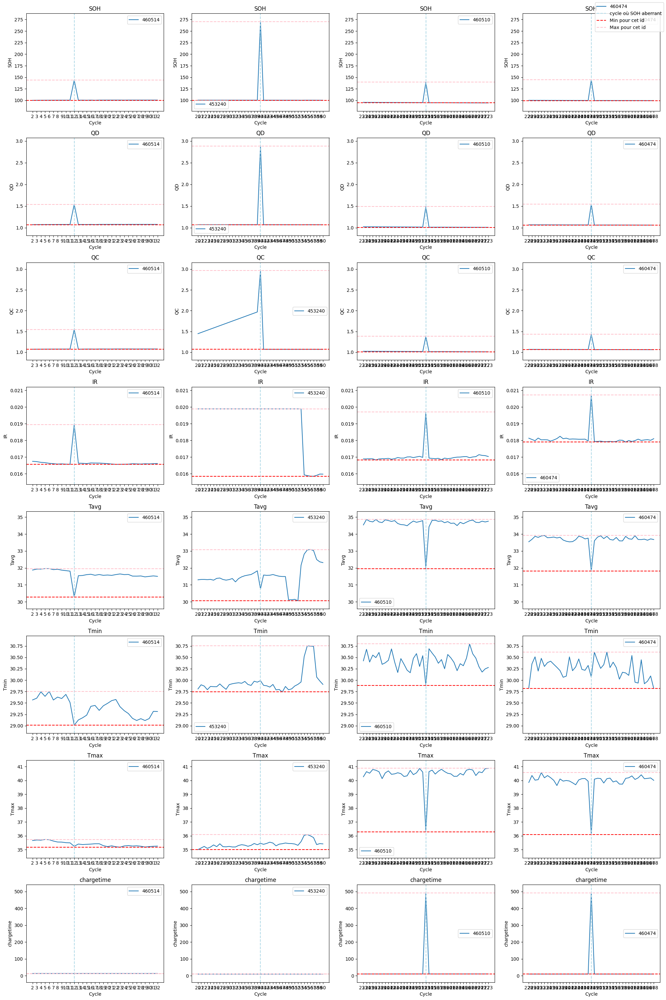

In [77]:
dfs = [df_460514, df_453240, df_460510, df_460474]
titles = ['460514', '453240', '460510', '460474']
columns = ['SOH', 'QD', 'QC', 'IR', 'Tavg', 'Tmin', 'Tmax', 'chargetime']
cycle_abberant = [12, 40, 253, 248]

min_vals, max_vals = get_min_max_values(dfs, columns)

min_vals_id0, max_vals_id0 = get_min_max_values([df_460514], columns)
min_vals_id14, max_vals_id14 = get_min_max_values([df_453240], columns)
min_vals_id50, max_vals_id50 = get_min_max_values([df_460510], columns)
min_vals_id80, max_vals_id80 = get_min_max_values([df_460474], columns)

list_min_vals = [min_vals_id0, min_vals_id14, min_vals_id50, min_vals_id80]
list_max_vals = [max_vals_id0, max_vals_id14, max_vals_id50, max_vals_id80]

fig, axes = plt.subplots(len(columns), len(dfs), figsize=(20, 30))  

for i, column in enumerate(columns):  
    for j, df_ in enumerate(dfs):
        ax = axes[i, j]  
        ax.plot(df_['cycle'], df_[column], label=f'{titles[j]}')

        ax.set_xlabel('Cycle')
        ax.set_ylabel(column)
        ax.set_title(f'{column}')
        ax.legend()

        ax.axvline(cycle_abberant[j], color='lightblue', linestyle='--', label='cycle où SOH aberrant')

        ax.axhline(list_min_vals[j][column], color='red', linestyle='--', label='Min pour cet id')
        ax.axhline(list_max_vals[j][column], color='pink', linestyle='--', label='Max pour cet id')

        # Ajuster les limites des axes Y en fonction des valeurs min et max globales pour chaque colonne
        envergure = max_vals[column] - min_vals[column]
        ax.set_ylim(min_vals[column] - envergure * 0.1, max_vals[column] + envergure * 0.1)

        ax.set_xticks(np.arange(df_['cycle'].min(), df_['cycle'].max() + 1, 1)) 

handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right')

plt.tight_layout()
plt.show()


Rappel : SOH est calculé en utilisant QD.  
On a affiché ce qu'il se passe au moment où on trouve des valeurs aberrantes (au dela de 102 %) 
pour toutes les variables de `summary`.

On observe bien des variations dans les autres variables, quelque chose ne fonctionne pas comme prévu.
Mais entre chaque série représentée au dessus, ce n'est pas les mêmes comportements (en dehors de id 50 et 80 qui ont les mêmes tendances, pics et chutes...)

On pourrait garder ces 4 valeurs aberrantes, mais faire un lissage ou remplacer les données pour toutes les colonnes à ce moment du cycle représentent un biais que l'on trouve trop important. 

On conclu donc que l'on va supprimer ces 4 séries temporelles.
Supprimer 4 séries / 124 nous semble raisonnable.

In [78]:
# Supprimer toutes les données où id = 0, 14, 50 ou 80 
print(df.shape)
df = df[~df['barcode'].isin([460514, 453240, 460510, 460474])]
print(df.shape)

(100460, 17)
(96951, 17)


## Analyse exploratoire 

In [79]:
# Créer une figure interactive avec Plotly
fig = px.line(
    df,
    x='cycle',
    y='SOH',
    color='barcode', 
    title="Évolution de SOH pour différents ID",
    labels={"cycle": "Cycle", "SOH": "SOH (%)"},
)
fig.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Barcode",
    hovermode="x unified",
)
fig.show()

In [80]:
# TODO fix ici : plus rien ne s'affiche 
# N'afficher que les données du batch 1
df_batch1 = df[df['batch'] == '1']
fig1 = px.line(
    df_batch1,
    x='cycle',
    y='SOH',
    color='barcode',
    title="Évolution de SOH pour différents ID de batch 1",
    labels={"cycle": "Cycle", "SOH": "SOH (%)"},
)
fig1.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Barcode",
    hovermode="x unified",
    width=1200,
    height=400,
)
fig1.show()

# N'afficher que les données du batch 2
df_batch2 = df[df['batch'] == '2']
fig2 = px.line(
    df_batch2,
    x='cycle',
    y='SOH',
    color='barcode',
    title="Évolution de SOH pour différents ID de batch 2",
    labels={"cycle": "Cycle", "SOH": "SOH (%)"},
)
fig2.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Barcode",
    hovermode="x unified",
    width=1200,
    height=400,
)
fig2.show()

# N'afficher que les données du batch 3
df_batch3 = df[df['batch'] == '3']
fig3 = px.line(
    df_batch3,
    x='cycle',
    y='SOH',
    color='barcode',
    title="Évolution de SOH pour différents ID de batch 3",
    labels={"cycle": "Cycle", "SOH": "SOH (%)"},
)
fig3.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Barcode",
    hovermode="x unified",
    width=1200,
    height=400,
)
fig3.show()

### Visualiser la courbe "représentative" de chaque batch 
On voit que chaque batch a une courbe moyenne représentative assez distincte des autres.

Il existe différentes manières de représenter une courbe moyenne / représentative pour une série temporelle

TODO : cours BL 

TODO : il manque genre DTW / DBA, distance euclidienne (fin genre calculer la séquence moyenne en utilisant ces deux méthodes)

et les affichers


In [81]:
# Lissage avec une moyenne mobile 
df_mean = df.groupby(['batch', 'cycle']).agg({'SOH': 'mean'}).reset_index()

# Lissage avec une moyenne mobile 
def smooth_series(series, window=5):
    return series.rolling(window=window, center=True).mean()

df_mean['SOH_smoothed_window5'] = df_mean.groupby('batch')['SOH'].transform(lambda x: smooth_series(x, window=5))
df_mean['SOH_smoothed_window10'] = df_mean.groupby('batch')['SOH'].transform(lambda x: smooth_series(x, window=10))

fig1 = px.line(
    df_mean,
    x='cycle',
    y='SOH_smoothed_window5', 
    color='batch',
    title="Courbe représentative de SOH pour chaque batch (lissage avec moyenne mobile, fenêtre de 5 cycles)",
    labels={"cycle": "Cycle", "SOH_smoothed_window5": "SOH (%)"},
)
fig1.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Batch",
    hovermode="x unified",
    width=1000, 
    height=300  
)
fig1.show()

fig2 = px.line(
    df_mean,
    x='cycle',
    y='SOH_smoothed_window10', 
    color='batch',
    title="Courbe représentative de SOH pour chaque batch (lissage avec moyenne mobile, fenêtre de 10 cycles)",
    labels={"cycle": "Cycle", "SOH_smoothed_window10": "SOH (%)"},
)
fig2.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Batch",
    hovermode="x unified",
    width=1000,  
    height=300 
)
fig2.show()

In [82]:
# Lissage avec mono expo
# Fonction de lissage mono-exponentiel
def exponential_smooth(series, alpha=0.1):
    return series.ewm(alpha=alpha, adjust=False).mean()

# Fonction de lissage double-exponentiel
def double_exponential_smooth(series, alpha=0.1, beta=0.1):
    smoothed = exponential_smooth(series, alpha)
    trend = exponential_smooth(smoothed, beta)
    return smoothed + trend - smoothed

# Fonction de lissage triple-exponentiel
def triple_exponential_smooth(series, alpha=0.1, beta=0.1, gamma=0.1):
    smoothed = exponential_smooth(series, alpha)
    trend = double_exponential_smooth(series, alpha, beta)
    seasonal = series - smoothed - trend
    seasonal_smoothed = exponential_smooth(seasonal, gamma)
    return smoothed + trend + seasonal_smoothed

# Appliquer le lissage sur les données de chaque batch
df_mean = df.groupby(['batch', 'cycle']).agg({'SOH': 'mean'}).reset_index()

# Lissage avec exponentiels simples, doubles et triples
df_mean['SOH_smoothed_expo'] = df_mean.groupby('batch')['SOH'].transform(lambda x: exponential_smooth(x, alpha=0.1))
df_mean['SOH_smoothed_double_expo'] = df_mean.groupby('batch')['SOH'].transform(lambda x: double_exponential_smooth(x, alpha=0.1, beta=0.1))
df_mean['SOH_smoothed_triple_expo'] = df_mean.groupby('batch')['SOH'].transform(lambda x: triple_exponential_smooth(x, alpha=0.1, beta=0.1, gamma=0.1))

# Créer les graphiques pour chaque type de lissage
fig1 = px.line(
    df_mean,
    x='cycle',
    y='SOH_smoothed_expo', 
    color='batch',
    title="Courbe représentative de SOH pour chaque batch (lissage mono-exponentiel)",
    labels={"cycle": "Cycle", "SOH_smoothed_expo": "SOH (%)"},
)
fig1.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Batch",
    hovermode="x unified",
    width=1000, 
    height=300  
)
fig1.show()

fig2 = px.line(
    df_mean,
    x='cycle',
    y='SOH_smoothed_double_expo', 
    color='batch',
    title="Courbe représentative de SOH pour chaque batch (lissage double-exponentiel)",
    labels={"cycle": "Cycle", "SOH_smoothed_double_expo": "SOH (%)"},
)
fig2.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Batch",
    hovermode="x unified",
    width=1000,  
    height=300 
)
fig2.show()

fig3 = px.line(
    df_mean,
    x='cycle',
    y='SOH_smoothed_triple_expo', 
    color='batch',
    title="Courbe représentative de SOH pour chaque batch (lissage triple-exponentiel)",
    labels={"cycle": "Cycle", "SOH_smoothed_triple_expo": "SOH (%)"},
)
fig3.update_layout(
    xaxis_title="Cycle",
    yaxis_title="SOH (%)",
    legend_title="Batch",
    hovermode="x unified",
    width=1000,  
    height=300 
)
fig3.show()


On voit bien qu'il y a des différences marquantes entre les différents batchs, surtout entre le batch 2 et les deux autres batchs.

On va donc essayer d'ajouter des données issue de la documentation (en les reliant avec la donnée du batch associé)
afin de prendre en compte un maximum d'informations.

##### Ajout informtations de la documentation

D'après la documentation : 
> Internal resistance measurements were obtained during charging at 80% SOC by averaging 10 pulses of ±3.6C with a pulse width of 30 ms (2017-05-12 and 2017-06-30) or 33 ms (2018-04-12).

On va donc ajouter une colonne pulse_width et pour les données du batch 1 et 2 mettre 30, et 33 pour le batch 3.

In [83]:
# Ajouter colonne pour pulse_width
df['pulse_width'] = 0
df.loc[df['batch'] == 1, 'pulse_width'] = 30
df.loc[df['batch'] == 2, 'pulse_width'] = 30
df.loc[df['batch'] == 3, 'pulse_width'] = 33

D'après la documentation : 
> We cycle to x% of nominal capacity (0.88 Ah).

On va donc ajouter une colonne cycle_to_x%.

In [84]:
# Ajouter une colonne de "cycle to x% of nominal capacity"
df['cycle_to_x%'] = 0
df.loc[df['batch'] == 1, 'cycle_to_x%'] = 80
df.loc[df['batch'] == 2, 'cycle_to_x%'] = 75
df.loc[df['batch'] == 3, 'cycle_to_x%'] = 80

D'après la documentation : 
>  The cutoff currents for the constant-voltage steps were C/xx for both charge and discharge.

On va donc ajouter une colonne 

In [85]:
# Ajouter une colonne "cutoff currents"
df['cutoff_currents'] = 0
df.loc[df['batch'] == 1, 'cutoff_currents'] = 50
df.loc[df['batch'] == 2, 'cutoff_currents'] = 50
df.loc[df['batch'] == 3, 'cutoff_currents'] = 20

#### Batch 1 : 
- [ ] 1 minute and 1 second rests were placed after reaching 80% SOC during charging and after discharging, respectively.
- [ ] An initial C/10 cycle was performed in the beginning of each test.
- [x] The cutoff currents for the constant-voltage steps were C/50 for both charge and discharge.
- [x] We cycle to 80% of nominal capacity (0.88 Ah).
- [x] The pulse width of the IR test is 30 ms.

#### Batch 2 : 
- [ ] 5 minute rests were placed both after reaching 80% SOC during charging and after discharging.
- [ ] An initial C/10 cycle was performed in the beginning of each test.
- [x] The cutoff currents for the constant-voltage steps were C/50 for both charge and discharge.
- [x] We cycle to 75% of nominal capacity (0.88 Ah).
- [x] The pulse width of the IR test is 30 ms.

#### Batch 3 : 
- [ ] Four 5-second rests were placed after reaching 80% SOC during charging, after the IR test, before discharging, and after discharging.
- [ ] A final C/10 cycle was performed at 80% of nominal capacity.
- [x] The cutoff currents for the constant-voltage steps were C/20 for both charge and discharge.
- [x] We cycle to 80% of nominal capacity (0.88 Ah).
- [x] The pulse width of the IR test is 33 ms.


In [86]:
# Ajouter une colonne "charging_rest", "after_discharging_rest", "before_discharging_rest", "IR_rest"
df['charging_rest'] = 0
df['after_discharging_rest'] = 0
df['before_discharging_rest'] = 0
df['IR_rest'] = 0

df.loc[df['batch'] == 1, 'charging_rest'] = 60 # 1 minute
df.loc[df['batch'] == 1, 'after_discharging_rest'] = 1 # 1 seconde
df.loc[df['batch'] == 1, 'before_discharging_rest'] = 0 # pas précisé on considère qu'il n'y a pas de pause
df.loc[df['batch'] == 1, 'IR_rest'] = 0 # pas précisé on considère qu'il n'y a pas de pause

df.loc[df['batch'] == 2, 'charging_rest'] = 5*60 # 5 minutes
df.loc[df['batch'] == 2, 'after_discharging_rest'] = 5*60 # 5 minutes
df.loc[df['batch'] == 2, 'before_discharging_rest'] = 0 # pas précisé on considère qu'il n'y a pas de pause
df.loc[df['batch'] == 2, 'IR_rest'] = 0 # pas précisé on considère qu'il n'y a pas de pause

df.loc[df['batch'] == 3, 'charging_rest'] = 5 # 5 secondes
df.loc[df['batch'] == 3, 'after_discharging_rest'] = 5 # 5 secondes
df.loc[df['batch'] == 3, 'before_discharging_rest'] = 5 # 5 secondes
df.loc[df['batch'] == 3, 'IR_rest'] = 5 # 5 secondes


In [87]:
df['charging_rest'].unique()

array([ 60, 300,   5])

On ne mets pas de colonne correspondante à 
> A final C/10 cycle was performed at 80% of nominal capacity.  

car on doit enfaite discriminer les données des batch 1 et 2 du batch 3 et `cutoff_currents` le fait déjà

In [88]:
# TODO : est ce qu'on doit y faire quelque chose ?
# batch 1 : The thermocouples for channels 15 and 16 were accidentally switched
# batch 2 idem 
# (dans leur doc respectives)

On ne supprime pas dans le Batch 2 Channel 10 : 
>  Channel 10 (EL150800460605), dies quite quickly. This cell is possibly defective, although we detected no obvious signs of this.

car on considère qu'il n'y a rien qui prouve que ce test était défectueux.

In [89]:
df[(df['batch'] == '2') & (df['channel_id'] == 10)]

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,cycle,IR,QC,...,chargetime,Qnominale,SOH,pulse_width,cycle_to_x%,cutoff_currents,charging_rest,after_discharging_rest,before_discharging_rest,IR_rest


> Batch 3 : The cell in channel 46 has noisy voltage profiles, likely due to an electronic connection error.

In [90]:
df[(df['batch'] == '3') & (df['channel_id'] == 46)]

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,cycle,IR,QC,...,chargetime,Qnominale,SOH,pulse_width,cycle_to_x%,cutoff_currents,charging_rest,after_discharging_rest,before_discharging_rest,IR_rest


In [91]:
# On n'a pas cette donnée (elle a peut être déjà été supprimée)

### TODO peut etre : Gestion valeurs aberrantes (genre des grosses baisses dans la courbe de SOH) ?

### TODO continuer l'analyse exploratoire ggraphique / visuelle : plot toutes les variables ...

## Préparation des données

In [92]:
df.head()

,barcode,channel_id,batch,cycle_life,C1,C2,Q1,cycle,IR,QC,...,chargetime,Qnominale,SOH,pulse_width,cycle_to_x%,cutoff_currents,charging_rest,after_discharging_rest,before_discharging_rest,IR_rest
1852,460486,2,1,2160,3.6,3.6,80,2,0.017039,1.075059,...,13.426057,1.075301,100.000000,30,80,50,60,1,0,0
1853,460486,2,1,2160,3.6,3.6,80,3,0.017010,1.076450,...,13.341520,1.075301,100.121938,30,80,50,60,1,0,0
1854,460486,2,1,2160,3.6,3.6,80,4,0.016928,1.077113,...,13.425830,1.075301,100.185715,30,80,50,60,1,0,0
1855,460486,2,1,2160,3.6,3.6,80,5,0.016915,1.077759,...,13.426093,1.075301,100.264977,30,80,50,60,1,0,0
1856,460486,2,1,2160,3.6,3.6,80,6,0.016859,1.078350,...,13.426250,1.075301,100.301571,30,80,50,60,1,0,0


In [93]:
df.dtypes

barcode                      int64
channel_id                   int64
batch                        int64
cycle_life                   int64
C1                         float64
C2                         float64
Q1                           int64
cycle                        int64
IR                         float64
QC                         float64
QD                         float64
Tavg                       float64
Tmin                       float64
Tmax                       float64
chargetime                 float64
Qnominale                  float64
SOH                        float64
pulse_width                  int64
cycle_to_x%                  int64
cutoff_currents              int64
charging_rest                int64
after_discharging_rest       int64
before_discharging_rest      int64
IR_rest                      int64
dtype: object

In [94]:
# Supprimer le numéro de batch, le channel_id, QD et Qnominale
df = df.drop(columns=['batch', 'channel_id', 'QD', 'Qnominale'])

# TODO avis : je me demande si le Qnominale on peut pas le garder pcq en vrai 
# quand on achète une batterie on peut savoir son Qnomminale non ?
# et étudier l'impact de la valeur initiale ?

On utilise 2 méthodes d'encodage : les modèles que l'on doit tester dans ce projet ne nécessite pas forcément les mêmes "normes". Certains modèles 
# TODO ZOE tu as réparti comment entre binary et label ?
nécessitent des odnnées Label encodé, d'autres on a préféré utioisé un Binary encoder (car One Hot encoding aurait généré trop de colonnes).

In [95]:
# Créer une copie du DataFrame pour éviter les modifications accidentelles
df_encoded = df.copy()

# Label Encoding
le = LabelEncoder()
df_encoded['barcode_label'] = le.fit_transform(df_encoded['barcode'])

# Binary Encoding
be = BinaryEncoder(cols=['barcode'])
df_binary = be.fit_transform(df[['barcode']])

# Ajouter les colonnes binaires au DataFrame principal
df_encoded = pd.concat([df_encoded, df_binary], axis=1)

# Afficher les premières lignes
df_encoded.head()


,barcode,cycle_life,C1,C2,Q1,cycle,IR,QC,Tavg,Tmin,...,before_discharging_rest,IR_rest,barcode_label,barcode_0,barcode_1,barcode_2,barcode_3,barcode_4,barcode_5,barcode_6
1852,460486,2160,3.6,3.6,80,2,0.017039,1.075059,31.668844,29.853098,...,0,0,14,0,0,0,0,0,0,1
1853,460486,2160,3.6,3.6,80,3,0.017010,1.076450,31.722740,29.857759,...,0,0,14,0,0,0,0,0,0,1
1854,460486,2160,3.6,3.6,80,4,0.016928,1.077113,31.748258,30.133654,...,0,0,14,0,0,0,0,0,0,1
1855,460486,2160,3.6,3.6,80,5,0.016915,1.077759,31.773122,29.960548,...,0,0,14,0,0,0,0,0,0,1
1856,460486,2160,3.6,3.6,80,6,0.016859,1.078350,31.767231,30.106787,...,0,0,14,0,0,0,0,0,0,1


In [96]:
df = df_encoded.copy()

In [97]:
# Normalisation / standardisation des données (nécessaire pour certains modèles)
scaler = MinMaxScaler()
df[['C1', 'C2', 'Q1', 
    'IR', 'QC', 
    'Tavg', 'Tmin', 'Tmax', 
    'chargetime', 
    'cycle_life',
    'pulse_width', 'cycle_to_x%', 'cutoff_currents', 
    'charging_rest', 'after_discharging_rest', 'before_discharging_rest', 'IR_rest']] = scaler.fit_transform(df[['C1', 'C2', 'Q1', 
                                                                                                                 'IR', 'QC', 
                                                                                                                 'Tavg', 'Tmin', 'Tmax',
                                                                                                                 'chargetime',
                                                                                                                 'cycle_life',
                                                                                                                 'pulse_width', 'cycle_to_x%', 'cutoff_currents', 
                                                                                                                 'charging_rest', 'after_discharging_rest', 'before_discharging_rest', 'IR_rest']])


# Ajout de la colonne du cycle normalisé
df['cycle_normalized'] = scaler.fit_transform(df[['cycle']])

df.head()

,barcode,cycle_life,C1,C2,Q1,cycle,IR,QC,Tavg,Tmin,...,IR_rest,barcode_label,barcode_0,barcode_1,barcode_2,barcode_3,barcode_4,barcode_5,barcode_6,cycle_normalized
1852,460486,0.96314,0.371429,0.2,1.0,2,0.698162,0.906962,0.455758,0.608091,...,0.0,14,0,0,0,0,0,0,1,0.000447
1853,460486,0.96314,0.371429,0.2,1.0,3,0.696973,0.911626,0.459462,0.608398,...,0.0,14,0,0,0,0,0,0,1,0.000895
1854,460486,0.96314,0.371429,0.2,1.0,4,0.693637,0.913850,0.461216,0.626557,...,0.0,14,0,0,0,0,0,0,1,0.001342
1855,460486,0.96314,0.371429,0.2,1.0,5,0.693099,0.916015,0.462925,0.615163,...,0.0,14,0,0,0,0,0,0,1,0.001790
1856,460486,0.96314,0.371429,0.2,1.0,6,0.690801,0.917999,0.462521,0.624789,...,0.0,14,0,0,0,0,0,0,1,0.002237


In [98]:
df.columns

Index(['barcode', 'cycle_life', 'C1', 'C2', 'Q1', 'cycle', 'IR', 'QC', 'Tavg',
       'Tmin', 'Tmax', 'chargetime', 'SOH', 'pulse_width', 'cycle_to_x%',
       'cutoff_currents', 'charging_rest', 'after_discharging_rest',
       'before_discharging_rest', 'IR_rest', 'barcode_label', 'barcode_0',
       'barcode_1', 'barcode_2', 'barcode_3', 'barcode_4', 'barcode_5',
       'barcode_6', 'cycle_normalized'],
      dtype='object')

In [99]:
# Afficher la description statistique en deux parties
df[['barcode', 'cycle_life', 'C1', 'C2', 'Q1', 'cycle', 'IR', 'QC', 'Tavg',
    'Tmin', 'Tmax', 'chargetime', 'SOH', 'pulse_width', 'cycle_to_x%',
    'cutoff_currents', 'charging_rest', 'after_discharging_rest']].describe()



,barcode,cycle_life,C1,C2,Q1,cycle,IR,QC,Tavg,Tmin,Tmax,chargetime,SOH,pulse_width,cycle_to_x%,cutoff_currents,charging_rest,after_discharging_rest
count,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000
mean,578653.183247,0.390912,0.612976,0.382038,0.595391,485.534177,0.680810,0.761454,0.624857,0.701541,0.666263,0.001737,96.440896,0.425370,0.787965,0.574630,0.279638,0.217726
std,136739.474020,0.218139,0.151377,0.245506,0.292662,381.646202,0.054589,0.171960,0.130269,0.098798,0.143358,0.004928,4.770293,0.494401,0.408752,0.494401,0.382679,0.405843
min,440551.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,76.646759,0.000000,0.000000,0.000000,0.000000,0.000000
25%,460611.000000,0.233605,0.542857,0.200000,0.371795,203.000000,0.637440,0.704716,0.540318,0.624847,0.574697,0.000898,95.027246,0.000000,1.000000,0.000000,0.000000,0.000000
50%,463882.000000,0.340833,0.614286,0.333333,0.615385,408.000000,0.678405,0.820431,0.612079,0.687890,0.680015,0.001098,98.288817,0.000000,1.000000,1.000000,0.186441,0.013378
75%,737313.000000,0.445189,0.657143,0.533333,0.833333,671.000000,0.710619,0.881478,0.714242,0.775178,0.773002,0.001869,99.812009,1.000000,1.000000,1.000000,0.186441,0.013378
max,739495.000000,1.000000,1.000000,1.000000,1.000000,2236.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,101.163855,1.000000,1.000000,1.000000,1.000000,1.000000


In [100]:
df[['before_discharging_rest', 'IR_rest', 'barcode_label', 'barcode_0',
       'barcode_1', 'barcode_2', 'barcode_3', 'barcode_4', 'barcode_5',
       'barcode_6', 'cycle_normalized']].describe()

,before_discharging_rest,IR_rest,barcode_label,barcode_0,barcode_1,barcode_2,barcode_3,barcode_4,barcode_5,barcode_6,cycle_normalized
count,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000
mean,0.425370,0.425370,66.282617,0.516405,0.453703,0.486648,0.413240,0.465565,0.499304,0.500696,0.216794
std,0.494401,0.494401,35.137394,0.499733,0.497855,0.499824,0.492418,0.498815,0.500002,0.500002,0.170759
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,38.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.090380
50%,0.000000,0.000000,72.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.182103
75%,1.000000,1.000000,97.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.299776
max,1.000000,1.000000,119.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [101]:
# ! Les colonnes non normalisés: barcode, cycle, SOH, barcode_label

In [102]:
# Pas de valeurs manquantes

On encode/normalise pas `cycle` car c'est une donnée qui va être utilisée pour créer les fenêtres glissantes   
et donc on a besoin de conserver l'ordre, mais on va bien la normaliser avant de la passer dans le modèle  
(on les garde pour l'instant car peut être que le numéro de cycle a une influence sur le SOH).

On ne normalise pas SOH car c'est notre target de prédiction

Barcode va être supprimé au niveau des modèles de ML (certain modèles garderont le barcode label encoded, d'autres en binary encoding). C'est important de garder le lien entre les barcodes pour identifier la même batterie dans les données à différents moments dans les fenêtres temporelles créées.


In [103]:
def get_min_max_cycle_value(df, barcode):
    return df[df['barcode'] == barcode]['cycle'].min(), df[df['barcode'] == barcode]['cycle'].max()

In [104]:
print(get_min_max_cycle_value(df, 460486)) # ok

(np.int64(2), np.int64(2159))


In [105]:
def get_nb_windows(df, window_size, stride):
    nb_windows = 0
    for barcode in df['barcode'].unique():
        min_cycle, max_cycle = get_min_max_cycle_value(df, barcode)
        for i in range(min_cycle, max_cycle - window_size + 1, stride):
            nb_windows += 1
            get_last_cycle = i + window_size - 1
        if max_cycle - get_last_cycle + 1 >= 5: # TODO à voir : ici on peut régler le 5 (si stride de 5s ?)
            nb_windows += 1
    return nb_windows

df_test = df[df['barcode'] == 460486]
get_nb_windows(df_test, 100, 50) # 43

43

In [106]:
assert df['barcode'].nunique() ==  df['barcode_label'].nunique()

In [107]:
# sauvegarder les colonnes dans SOH pour connaitre à quoi correspond chaque indice
features_= df.columns.drop('SOH').to_list()
features_columns = {i: features_[i] for i in range(len(features_))}
features_columns

{0: 'barcode',
 1: 'cycle_life',
 2: 'C1',
 3: 'C2',
 4: 'Q1',
 5: 'cycle',
 6: 'IR',
 7: 'QC',
 8: 'Tavg',
 9: 'Tmin',
 10: 'Tmax',
 11: 'chargetime',
 12: 'pulse_width',
 13: 'cycle_to_x%',
 14: 'cutoff_currents',
 15: 'charging_rest',
 16: 'after_discharging_rest',
 17: 'before_discharging_rest',
 18: 'IR_rest',
 19: 'barcode_label',
 20: 'barcode_0',
 21: 'barcode_1',
 22: 'barcode_2',
 23: 'barcode_3',
 24: 'barcode_4',
 25: 'barcode_5',
 26: 'barcode_6',
 27: 'cycle_normalized'}

In [108]:
df.describe()

,barcode,cycle_life,C1,C2,Q1,cycle,IR,QC,Tavg,Tmin,...,IR_rest,barcode_label,barcode_0,barcode_1,barcode_2,barcode_3,barcode_4,barcode_5,barcode_6,cycle_normalized
count,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,...,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000,96951.000000
mean,578653.183247,0.390912,0.612976,0.382038,0.595391,485.534177,0.680810,0.761454,0.624857,0.701541,...,0.425370,66.282617,0.516405,0.453703,0.486648,0.413240,0.465565,0.499304,0.500696,0.216794
std,136739.474020,0.218139,0.151377,0.245506,0.292662,381.646202,0.054589,0.171960,0.130269,0.098798,...,0.494401,35.137394,0.499733,0.497855,0.499824,0.492418,0.498815,0.500002,0.500002,0.170759
min,440551.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,460611.000000,0.233605,0.542857,0.200000,0.371795,203.000000,0.637440,0.704716,0.540318,0.624847,...,0.000000,38.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.090380
50%,463882.000000,0.340833,0.614286,0.333333,0.615385,408.000000,0.678405,0.820431,0.612079,0.687890,...,0.000000,72.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.182103
75%,737313.000000,0.445189,0.657143,0.533333,0.833333,671.000000,0.710619,0.881478,0.714242,0.775178,...,1.000000,97.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.299776
max,739495.000000,1.000000,1.000000,1.000000,1.000000,2236.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,119.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [109]:
# Pour la fin du notebook:
# Extraire 5 indices entre min et max pour chaque barcode

dict_explicabilite_with_cycle = []
for i in dict_explicabilite:
    min_cycle, max_cycle = get_min_max_cycle_value(df, i['barcode'])
    random_cycles = random.sample(range(int(min_cycle), int(max_cycle)), 5)
    for cycle in random_cycles:
        dict_explicabilite_with_cycle.append({
            'batch': i['batch'],
            'barcode': i['barcode'],
            'min_cycle': min_cycle,
            'max_cycle': max_cycle,
            'indice': cycle
        })

dict_explicabilite_with_cycle

[{'batch': 1,
  'barcode': np.int64(460656),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(598),
  'indice': 225},
 {'batch': 1,
  'barcode': np.int64(460656),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(598),
  'indice': 240},
 {'batch': 1,
  'barcode': np.int64(460656),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(598),
  'indice': 519},
 {'batch': 1,
  'barcode': np.int64(460656),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(598),
  'indice': 29},
 {'batch': 1,
  'barcode': np.int64(460656),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(598),
  'indice': 576},
 {'batch': 1,
  'barcode': np.int64(465027),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(869),
  'indice': 205},
 {'batch': 1,
  'barcode': np.int64(465027),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(869),
  'indice': 735},
 {'batch': 1,
  'barcode': np.int64(465027),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(869),
  'indice': 667},
 {'batch': 1,
  'barcode': np.int

### Création de sliding windows flatten
On crée des données flatten car la plupart des modèles on besoin de ce format de données.
(Les RNN sont capables de gérer des données 3D pour des données temporelles, mais ce n'est pas le cas des autres modèles. Pour partir d'une même base commune, on a donc décidé dès la création des données de les avoir flatten.)

1. créer des sliding windows
    - cycle_normalized
    - IR
    - QC
    - Tavg
    - Tmin 
    - Tmax
    - chargetime  
    -- 7 
2. flatten
3. concaténer les données liées, on enregistre avant de supprimer pour la sliding windows : 
    - cycle_life
    - C1
    - C2
    - Q1
    - pulse_width
    - cycle_to_x%
    - cutoff_currents
    - charging_rest
    - after_discharging_rest
    - before_discharging_rest
    - IR_rest   
    -- 11

    - si label : 
        - barcode_label  
        -- 1
        -- somme 12 

    - si binary : 
        - barcode_0
        - barcode_1
        - barcode_2
        - barcode_3
        - barcode_4
        - barcode_5
        - barcode_6  
        -- 7 
        -- somme 18

    - > assert ces données sont bien uniques par window


-- = 26 : ok
    

In [110]:
features_windows = [
    'cycle_normalized',
    'IR',
    'QC',
    'Tavg',
    'Tmin', 
    'Tmax',
    'chargetime', 
]

In [111]:
# extraire les données qu'on va concaténer pour pas les dupliquer
features_extract_label = ['cycle_life', 
                            'C1', 
                            'C2', 
                            'Q1', 
                            'pulse_width', 
                            'cycle_to_x%', 
                            'cutoff_currents', 
                            'charging_rest', 
                            'after_discharging_rest', 
                            'before_discharging_rest', 
                            'IR_rest', 
                            'barcode_label', 
]
assert len(features_extract_label) == 12, f'Nombre de features différent de ce qui est attendu : {len(features_extract_label)} != 12'

features_extract_binary = ['cycle_life', 
                            'C1', 
                            'C2', 
                            'Q1', 
                            'pulse_width', 
                            'cycle_to_x%', 
                            'cutoff_currents', 
                            'charging_rest', 
                            'after_discharging_rest', 
                            'before_discharging_rest', 
                            'IR_rest',  
                            'barcode_0',
                            'barcode_1',
                            'barcode_2',
                            'barcode_3',
                            'barcode_4',
                            'barcode_5',
                            'barcode_6',  
]
assert len(features_extract_binary) == 18, f'Nombre de features différent de ce qui est attendu : {len(features_extract_binary)} != 18'


In [112]:
features_extract = list(set(features_extract_label + features_extract_binary))
len(features_extract)

19

### Sliding windows

TODO : expliquer ce qui est extrat, comment les fenetres sont formées
(attentioncolonnes avec valeurs uniques, commune au batch ou à la cellule (batterie) ne sont pas dupliquées pour chaque cycle, juste reconcaténer à la fin du dataset une fois la fenetre créée et flatten )

In [113]:
def create_sliding_windows(df, window_size, stride):
    nb_windows = get_nb_windows(df, window_size, stride)
    nb_features = len(features_columns)
    print(f'nb_windows : {nb_windows}')
    print(f'nb_features : {nb_features}')

    idx_explicabilite = []

    # X_np_3D = np.zeros((nb_windows, window_size, features_windows))
    
    X_np_2D_label = np.zeros((nb_windows, window_size * len(features_windows) + len(features_extract_label)))
    X_np_2D_binary = np.zeros((nb_windows, window_size * len(features_windows) + len(features_extract_binary)))
    y_np = np.zeros(nb_windows)


    window_idx = 0

    for barcode in df['barcode'].unique():
        min_cycle, max_cycle = get_min_max_cycle_value(df, barcode)
        for i in range(min_cycle, max_cycle - window_size + 1, stride):
            window_data = df[(df['barcode'] == barcode) & (df['cycle'] >= i) & (df['cycle'] < i + window_size)]

            # dans cette window data on extrait les données redondantes (commune à la colonne de cette window)
            # normalement c'est les données de features_extract_label et features_extract_binary
            window_data_redondant = window_data[features_extract]
            for j in features_extract:
                assert window_data[j].nunique() == 1, f'Problème avec les données : {j}'

            # remplace ces données par une seule ligne correspondant à la valeur (pour éviter d'avoir trop de colonnes avec informations redondantes)
            window_data_redondant = window_data_redondant.iloc[0]
            print(window_data_redondant.shape)
            assert window_data_redondant.shape[0] == len(features_extract), f'Problème avec la shape des données redondantes : {window_data_redondant.shape}'

            window_data_redondant_label = window_data_redondant[features_extract_label]
            assert window_data_redondant_label.shape[0] == len(features_extract_label)

            window_data_redondant_binary = window_data_redondant[features_extract_binary]
            assert window_data_redondant_binary.shape[0] == len(features_extract_binary)

            window_data_to_compute = window_data[features_windows]
            assert window_data_redondant.shape[0] + window_data_to_compute.shape[1] == window_data.shape[1] - 3 # SOH barcode et cycle

            get_last_cycle = i + window_size - 1

            # X_np_3D[window_idx, :, :] = window_data_to_compute.values

            print(f"window_data_to_compute.shape: {window_data_to_compute.values.flatten().shape}")
            print(f"window_data_redondant.shape: {window_data_redondant.shape}")

            X_np_2D_label[window_idx, :] = np.concatenate((window_data_to_compute.values.flatten(), window_data_redondant_label))
            print(f'label : {X_np_2D_label[window_idx, :].shape}')
            X_np_2D_binary[window_idx, :] = np.concatenate((window_data_to_compute.values.flatten(), window_data_redondant_binary))
            print(f'binary {X_np_2D_binary[window_idx, :].shape}')

            assert X_np_2D_label[window_idx, :].shape[0] == window_size * len(features_windows) + len(features_extract_label)
            assert X_np_2D_binary[window_idx, :].shape[0] == window_size * len(features_windows) + len(features_extract_binary)

            y_np[window_idx] = df[(df['barcode'] == barcode) & (df['cycle'] == get_last_cycle)]['SOH'].values[0]

            # si barcode dans dict_explicabilite_with_cycle
            # et que il y a un cycle qui correspond (indice - 5 à indice)
            # au i actuel alors on ajoute l'indice de la fenêtre dans le df flatten 
            # pour pouvoir retrouver les données correspondantes pour l'explicabilité
            # TODO et vérifier que cette indice n'a pas déjà été traité ?
            for d in dict_explicabilite_with_cycle:
                if d['barcode'] == barcode and i <= d['indice'] < i + stride:
                    idx_explicabilite.append({
                        'window_idx': window_idx,
                        'batch': d['batch'],
                        'barcode': d['barcode'],
                        'min_cycle': d['min_cycle'],
                        'max_cycle': d['max_cycle'],
                        'indice': d['indice']
                    })
            window_idx += 1

        taille_reste = max_cycle - get_last_cycle + 1
        window_reste = df[(df['barcode'] == barcode) & (df['cycle'] >= get_last_cycle)]
        assert window_reste.shape[0] == taille_reste, f'Taille différente de ce qui est attendu : {window_reste.shape[0]} != {taille_reste}'

        if taille_reste >= 5: # si la fenetre restante est trop petite : on l'ignore
            # prendre les window_size dernières données correspondantes au cycle
            cycle_fin = max_cycle - window_size + 1
            last_window_data = df[(df['barcode'] == barcode) & (df['cycle'] >= cycle_fin)]
            assert last_window_data['cycle'].max() == max_cycle , f'Problème avec les cycles : {last_window_data["cycle"].max()} != {max_cycle}'
            assert last_window_data.shape[0] == window_size, f'Taille différente de ce qui est attendu : {last_window_data.shape[0]} != {window_size}'

            last_window_data_redondant = last_window_data[features_extract]
            for j in features_extract:
                assert last_window_data[j].nunique() == 1, f'Problème avec les données : {j}'
            # remplace ces données par une seule ligne correspondant à la valeur
            last_window_data_redondant = last_window_data_redondant.iloc[0]
            assert last_window_data_redondant.shape[0] == len(features_extract), f'Problème avec la shape des données redondantes : {last_window_data_redondant.shape}'

            last_window_data_redondant_label = last_window_data_redondant[features_extract_label]
            assert last_window_data_redondant_label.shape[0] == len(features_extract_label)

            last_window_data_redondant_binary = last_window_data_redondant[features_extract_binary]
            assert last_window_data_redondant_binary.shape[0] == len(features_extract_binary)

            last_window_data_to_compute = last_window_data[features_windows]
            assert last_window_data_redondant.shape[0] + last_window_data_to_compute.shape[1] == last_window_data.shape[1] - 3 # SOH barcode et cycle

            # X_np_3D[window_idx, :, :] = last_window_data_to_compute.values
            y_np[window_idx] = df[(df['barcode'] == barcode) & (df['cycle'] == max_cycle)]['SOH'].values[0]

            X_np_2D_label[window_idx, :] = np.concatenate((last_window_data_to_compute.values.flatten(), last_window_data_redondant_label))
            X_np_2D_binary[window_idx, :] = np.concatenate((last_window_data_to_compute.values.flatten(), last_window_data_redondant_binary))
            assert X_np_2D_label[window_idx, :].shape[0] == window_size * len(features_windows) + len(features_extract_label)
            assert X_np_2D_binary[window_idx, :].shape[0] == window_size * len(features_windows) + len(features_extract_binary)

            for d in dict_explicabilite_with_cycle:
                if d['barcode'] == barcode and i <= d['indice'] < i + stride:
                    idx_explicabilite.append({
                        'window_idx': window_idx,
                        'batch': d['batch'],
                        'barcode': d['barcode'],
                        'min_cycle': d['min_cycle'],
                        'max_cycle': d['max_cycle'],
                        'indice': d['indice']
                    })
            window_idx += 1

    assert window_idx == nb_windows, f'Nombre de fenêtres différent de ce qui est attendu : {window_idx} != {nb_windows}'
    return X_np_2D_label, X_np_2D_binary, y_np, idx_explicabilite

On essaye de capturer la dernière fenêtre (même si elle n'est pas alignée avec la taille de la fenêtre / du stride).
Pour cela, on considère qu'on récupère les window_size dernières données (dernière feneêtre) si elle est composée d'au moins 5 valeurs manquantes.


# TODO est c que comme on prend 20w 10s on essaye de réduire ? 

In [114]:
# df_test pour vérifier le bon fonctionnement de nos sliding windows
df_test = df[df['barcode_label'] == 14] 

test_X_np_2D_label, test_X_np_2D_binary, test_y_np, _ = create_sliding_windows(df_test, 100, 50)

nb_windows : 43
nb_features : 28
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,

In [115]:
test_X_np_2D_label.shape

(43, 712)

In [116]:
# Vérifierque  toutes les colonnes correspondant à window sont entre 0 et 1 (standardisation/normalisation)
# sauf barcode_label 

# Récupérer l'ordre des colonnes:
# les x derniers c'est : features_extract_label 
# les x premiers c'est : features_windows _ numéro windows
# Créer le tableau correspondant

window_size = 100 
colonnes_labels = []
for i in range(1, window_size+1): # 1 à 100 
    for j in features_windows: # 7 
        colonnes_labels.append(f'{j}_{i}')
for j in features_extract_label:
    colonnes_labels.append(j)
print(len(colonnes_labels))
# afficher les 12 derniers
# et les 14 prermiers
print(colonnes_labels[-15:])
print(colonnes_labels[:14])

712
['Tmin_100', 'Tmax_100', 'chargetime_100', 'cycle_life', 'C1', 'C2', 'Q1', 'pulse_width', 'cycle_to_x%', 'cutoff_currents', 'charging_rest', 'after_discharging_rest', 'before_discharging_rest', 'IR_rest', 'barcode_label']
['cycle_normalized_1', 'IR_1', 'QC_1', 'Tavg_1', 'Tmin_1', 'Tmax_1', 'chargetime_1', 'cycle_normalized_2', 'IR_2', 'QC_2', 'Tavg_2', 'Tmin_2', 'Tmax_2', 'chargetime_2']


In [117]:
# à quel indice se trouve barcode_label ?
colonnes_labels.index('barcode_label')

711

In [118]:
# vérifier toutes les colonnes correspondant à window sont entre 0 et 1 
# sauf barcode_label 

for i in range(len(colonnes_labels)):
    if i == colonnes_labels.index('barcode_label'):
        continue
    # vérifier que toutes les valeurs de la colonne sontn entre 0 et 1
    assert np.all((test_X_np_2D_label[:, i] >= 0) & (test_X_np_2D_label[:, i] <= 1)), f'Problème avec la colonne {i}'

In [119]:
test_X_np_2D_binary.shape

(43, 718)

In [120]:
test_y_np.shape

(43,)

In [121]:
colonnes_binary = []
for i in range(1, window_size+1): # 1 à 100 
    for j in features_windows: # 7 
        colonnes_binary.append(f'{j}_{i}')
for j in features_extract_binary:
    colonnes_binary.append(j)
print(len(colonnes_binary))
print(colonnes_binary[-20:])
print(colonnes_binary[:14])

718
['Tmax_100', 'chargetime_100', 'cycle_life', 'C1', 'C2', 'Q1', 'pulse_width', 'cycle_to_x%', 'cutoff_currents', 'charging_rest', 'after_discharging_rest', 'before_discharging_rest', 'IR_rest', 'barcode_0', 'barcode_1', 'barcode_2', 'barcode_3', 'barcode_4', 'barcode_5', 'barcode_6']
['cycle_normalized_1', 'IR_1', 'QC_1', 'Tavg_1', 'Tmin_1', 'Tmax_1', 'chargetime_1', 'cycle_normalized_2', 'IR_2', 'QC_2', 'Tavg_2', 'Tmin_2', 'Tmax_2', 'chargetime_2']


In [122]:
# Vérifier que toutes les colonnes correspondant à window sont entre 0 et 1 
for i in range(len(colonnes_binary)):
    # vérifier que toutes les valeurs de la colonne sont entre 0 et 1
    assert np.all((test_X_np_2D_binary[:, i] >= 0) & (test_X_np_2D_binary[:, i] <= 1)), f'Problème avec la colonne {i}'

### Fenêtres
Pour choisir la taille de fenêtre (window size) et le pas de décalage (stride), il faut trouver un équilibre entre :

- Capturer suffisamment de dépendances temporelles : Une fenêtre trop courte risque de ne pas contenir assez d'informations pour capturer les tendances.

- Préserver suffisamment de données pour l'entraînement : Une fenêtre trop longue réduit le nombre d'échantillons disponibles.

- Fenêtre courte (50 cycles) :
    - Pour capturer des variations locales et des tendances à court terme.
    - Utile si les modèles doivent détecter des anomalies ou des changements rapides dans le SOH.

- Fenêtre moyenne (100 cycles) :
    - Permet de capturer des variations modérées tout en conservant une taille de jeu de données décente.
    - Recommandée pour une analyse globale du SOH dans des batteries avec une durée de vie moyenne (ex. : ~860 cycles).

- Fenêtre longue (150+ cycles) :
    - Utile pour capturer des tendances sur une large période (par exemple, pour des batteries à longue durée de vie).

#### Stride (pas de décalage entre les fenêtres)

- Stride court (1-10 cycles) :
    - Fournit de nombreuses fenêtres avec des informations redondantes. Utile pour les modèles comme les RNN, qui bénéficient de plus de données.
    - Inconvénient : Calculs coûteux.
- Stride moyen (20-30 cycles) :
    - Réduit les redondances tout en gardant suffisamment d'échantillons.
    - Convient pour des modèles comme les forêts aléatoires ou les régressions (demandés dans notre énoncé).
- Stride long (50+ cycles) :
    - Réduit fortement la taille des données.
    - Utile si les calculs doivent être rapides.


On crée plusieurs datasets, de différentes tailles de fenêtres et de stride différents, qu'on utilisera dans 
# TODO citer le bon fichier 
`2_rf_search_window`
pour déterminer quelle est la combinaison optimale.

In [123]:
window_50w = 50
stride_20s = 20 
X_np_50w_20s_label, X_np_50w_20s_binary, y_np_50w_20s, _ = create_sliding_windows(df, window_50w, stride_20s)

nb_windows : 4711
nb_features : 28
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(1

In [124]:
window_100w = 100
X_np_100w_20s_label, X_np_100w_20s_binary, y_np_100w_20s, _ = create_sliding_windows(df, window_100w, stride_20s)

nb_windows : 4409
nb_features : 28
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(1

In [125]:
window_150w = 150
X_np_150w_20s_label, X_np_150w_20s_binary, y_np_150w_20s, _ = create_sliding_windows(df, window_150w, stride_20s)

nb_windows : 4111
nb_features : 28
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label : (1062,)
binary (1068,)
(19,)
window_data_to_compute.shape: (1050,)
window_data_redondant.shape: (19,)
label 

### Sauver les données en pickle

In [126]:
def get_features_names(window_size, features_extract):
    colonnes_labels = []
    for i in range(1, window_size+1): # 1 à 100 
        for j in features_windows: # 7 
            colonnes_labels.append(f'{j}_{i}')
    for j in features_extract:
        colonnes_labels.append(j)
    return colonnes_labels

print(get_features_names(100, features_extract_label)[-15:])
print(get_features_names(100, features_extract_binary)[-21:])

['Tmin_100', 'Tmax_100', 'chargetime_100', 'cycle_life', 'C1', 'C2', 'Q1', 'pulse_width', 'cycle_to_x%', 'cutoff_currents', 'charging_rest', 'after_discharging_rest', 'before_discharging_rest', 'IR_rest', 'barcode_label']
['Tmin_100', 'Tmax_100', 'chargetime_100', 'cycle_life', 'C1', 'C2', 'Q1', 'pulse_width', 'cycle_to_x%', 'cutoff_currents', 'charging_rest', 'after_discharging_rest', 'before_discharging_rest', 'IR_rest', 'barcode_0', 'barcode_1', 'barcode_2', 'barcode_3', 'barcode_4', 'barcode_5', 'barcode_6']


In [127]:
# 50w_20s 
donnees_50w_20s = {
    'X_np_label': X_np_50w_20s_label,
    'X_np_binary': X_np_50w_20s_binary,
    'y_np': y_np_50w_20s,
    'features_names_label': get_features_names(50, features_extract_label),
    'features_names_binary': get_features_names(50, features_extract_binary),
}
with open("Data/donnees_50w_20s.pkl", "wb") as file:
    pickle.dump(donnees_50w_20s, file)

# 100w_20s
donnees_100w_20s = {
    'X_np_label': X_np_100w_20s_label,
    'X_np_binary': X_np_100w_20s_binary,
    'y_np': y_np_100w_20s,
    'features_names_label': get_features_names(100, features_extract_label),
    'features_names_binary': get_features_names(100, features_extract_binary),
}
with open("Data/donnees_100w_20s.pkl", "wb") as file:
    pickle.dump(donnees_100w_20s, file)

# 150w_20s
donnees_150w_20s = {
    'X_np_label': X_np_150w_20s_label,
    'X_np_binary': X_np_150w_20s_binary,
    'y_np': y_np_150w_20s,
    'features_names_label': get_features_names(150, features_extract_label),
    'features_names_binary': get_features_names(150, features_extract_binary),
}
with open("Data/donnees_150w_20s.pkl", "wb") as file:
    pickle.dump(donnees_150w_20s, file)


In [128]:
stride_10s = 10
X_np_50w_10s_label, X_np_50w_10s_binary, y_np_50w_10s, _ = create_sliding_windows(df, window_50w, stride_10s)

nb_windows : 9240
nb_features : 28
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(1

In [129]:
X_np_100w_10s_label, X_np_100w_10s_binary, y_np_100w_10s, _ = create_sliding_windows(df, window_100w, stride_10s)

nb_windows : 8640
nb_features : 28
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(19,)
window_data_to_compute.shape: (700,)
window_data_redondant.shape: (19,)
label : (712,)
binary (718,)
(1

In [130]:
# 50w_10s 
donnees_50w_10s = {
    'X_np_label': X_np_50w_10s_label,
    'X_np_binary': X_np_50w_10s_binary,
    'y_np': y_np_50w_10s,
    'features_names_label': get_features_names(50, features_extract_label),
    'features_names_binary': get_features_names(50, features_extract_binary),
}
with open("Data/donnees_50w_10s.pkl", "wb") as file:
    pickle.dump(donnees_50w_10s, file)

# 100w_10s
donnees_100w_10s = {
    'X_np_label': X_np_100w_10s_label,
    'X_np_binary': X_np_100w_10s_binary,
    'y_np': y_np_100w_10s,
    'features_names_label': get_features_names(100, features_extract_label),
    'features_names_binary': get_features_names(100, features_extract_binary),
}
with open("Data/donnees_100w_10s.pkl", "wb") as file:
    pickle.dump(donnees_100w_10s, file)


In [131]:
# TODO à discuter : cycle_normalized ? je pense on devrait drop jsp trop si on doit le garder

In [132]:
stride_5s = 5
X_np_50w_5s_label, X_np_50w_5s_binary, y_np_50w_5s, _ = create_sliding_windows(df, window_50w, stride_5s)

nb_windows : 18290
nb_features : 28
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(19,)
window_data_to_compute.shape: (350,)
window_data_redondant.shape: (19,)
label : (362,)
binary (368,)
(

In [133]:
# 50w_5s
donnees_50w_5s = {
    'X_np_label': X_np_50w_5s_label,
    'X_np_binary': X_np_50w_5s_binary,
    'y_np': y_np_50w_5s,
    'features_names_label': get_features_names(50, features_extract_label),
    'features_names_binary': get_features_names(50, features_extract_binary),
}
with open("Data/donnees_50w_5s.pkl", "wb") as file:
    pickle.dump(donnees_50w_5s, file)

In [134]:
stride_10s = 10
window_30w = 30
X_np_30w_10s_label, X_np_30w_10s_binary, y_np_30w_10s, _ = create_sliding_windows(df, window_30w, stride_10s)

nb_windows : 9480
nb_features : 28
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(19,)
window_data_to_compute.shape: (210,)
window_data_redondant.shape: (19,)
label : (222,)
binary (228,)
(1

In [135]:
# 30w_10s
donnees_30w_10s = {
    'X_np_label': X_np_30w_10s_label,
    'X_np_binary': X_np_30w_10s_binary,
    'y_np': y_np_30w_10s,
    'features_names_label': get_features_names(30, features_extract_label),
    'features_names_binary': get_features_names(30, features_extract_binary),
}
with open("Data/donnees_30w_10s.pkl", "wb") as file:
    pickle.dump(donnees_30w_10s, file)

In [136]:
stride_10s = 10
window_20w = 20
X_np_20w_10s_label, X_np_20w_10s_binary, y_np_20w_10s, _ = create_sliding_windows(df, window_20w, stride_10s)

nb_windows : 9600
nb_features : 28
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(1

In [137]:
# 20w_10s
donnees_20w_10s = {
    'X_np_label': X_np_20w_10s_label,
    'X_np_binary': X_np_20w_10s_binary,
    'y_np': y_np_20w_10s,
    'features_names_label': get_features_names(20, features_extract_label),
    'features_names_binary': get_features_names(20, features_extract_binary),
}
with open("Data/donnees_20w_10s.pkl", "wb") as file:
    pickle.dump(donnees_20w_10s, file)

In [138]:
X_np_20w_5s_label, X_np_20w_5s_binary, y_np_20w_5s, idx_explicabilite_20w_5s = create_sliding_windows(df, window_20w, stride_5s)

nb_windows : 19010
nb_features : 28
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(19,)
window_data_to_compute.shape: (140,)
window_data_redondant.shape: (19,)
label : (152,)
binary (158,)
(

In [139]:
# Extraire un X_explicabilite associé aux window_idx

X_label_explicabilite = np.zeros((len(idx_explicabilite_20w_5s), X_np_20w_5s_label.shape[1]))
X_binary_explicabilite = np.zeros((len(idx_explicabilite_20w_5s), X_np_20w_5s_binary.shape[1]))
y_explicabilite = np.zeros(len(idx_explicabilite_20w_5s))

for i in range(len(idx_explicabilite_20w_5s)):
    idx = idx_explicabilite_20w_5s[i]['window_idx']
    X_label_explicabilite[i, :] = X_np_20w_5s_label[idx, :]
    X_binary_explicabilite[i, :] = X_np_20w_5s_binary[idx, :]
    y_explicabilite[i] = y_np_20w_5s[idx]

# Afficher les shape 
X_label_explicabilite.shape, X_binary_explicabilite.shape, y_explicabilite.shape

((73, 152), (73, 158), (73,))

In [140]:
# 20w_5s
donnees_20w_5s = {
    'X_np_label': X_np_20w_5s_label,
    'X_np_binary': X_np_20w_5s_binary,
    'y_np': y_np_20w_5s,
    'features_names_label': get_features_names(20, features_extract_label),
    'features_names_binary': get_features_names(20, features_extract_binary),
    'idx_explicabilite': idx_explicabilite_20w_5s,
    'X_label_explicabilite': X_label_explicabilite,
    'X_binary_explicabilite': X_binary_explicabilite,
    'y_explicabilite': y_explicabilite,
}
with open("Data/donnees_20w_5s.pkl", "wb") as file:
    pickle.dump(donnees_20w_5s, file)

In [141]:
# Extraction d'indices pour explicabilité

# On veut prendre aléatoirement 5 batteries pour chaque batch
# et pour chaque batterie on veut prendre aléatoirement 5 cycles

# Ensuite on doit trouver l'indice correspondant dans les données flatten 
# du dataset 20w_5s

idx_explicabilite_20w_5s

[{'window_idx': 5,
  'batch': 1,
  'barcode': np.int64(460486),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(2159),
  'indice': 28},
 {'window_idx': 180,
  'batch': 1,
  'barcode': np.int64(460486),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(2159),
  'indice': 904},
 {'window_idx': 227,
  'batch': 1,
  'barcode': np.int64(460486),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(2159),
  'indice': 1141},
 {'window_idx': 343,
  'batch': 1,
  'barcode': np.int64(460486),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(2159),
  'indice': 1720},
 {'window_idx': 367,
  'batch': 1,
  'barcode': np.int64(460486),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(2159),
  'indice': 1841},
 {'window_idx': 1868,
  'batch': 1,
  'barcode': np.int64(465027),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(869),
  'indice': 205},
 {'window_idx': 1939,
  'batch': 1,
  'barcode': np.int64(465027),
  'min_cycle': np.int64(2),
  'max_cycle': np.int64(869),
  'indice': 560},

In [142]:
# Combien a t on de données de chaque batch ?

b1, b2, b3 = 0, 0, 0
for i in idx_explicabilite_20w_5s:
    if i['batch'] == 1:
        b1 += 1
    elif i['batch'] == 2:
        b2 += 1
    else:
        b3 += 1

print(f'batch 1 : {b1}')
print(f'batch 2 : {b2}')
print(f'batch 3 : {b3}')

batch 1 : 24
batch 2 : 25
batch 3 : 24


In [143]:
# Combien de valeurs pour un barcode donné ?

dict_unique = {}
for i in idx_explicabilite_20w_5s:
    if i['barcode'] not in dict_unique:
        dict_unique[i['barcode']] = 1
    else:
        dict_unique[i['barcode']] += 1

for i in dict_unique:
    print(f'barcode {i} : {dict_unique[i]}')

barcode 460486 : 5
barcode 465027 : 5
barcode 464881 : 4
barcode 463871 : 5
barcode 460656 : 5
barcode 460635 : 5
barcode 460634 : 5
barcode 460466 : 5
barcode 440551 : 5
barcode 460627 : 5
barcode 737313 : 5
barcode 737280 : 5
barcode 737229 : 4
barcode 737320 : 5
barcode 739495 : 5


In [144]:
print(len(y_np_20w_5s))

# Vérifier que tous les window_idx sont uniques et < à la taille du dataset
for i in idx_explicabilite_20w_5s:
    assert i['window_idx'] < len(y_np_20w_5s), f'Problème avec la taille du dataset : {i["window_idx"]}'

19010


In [145]:
# Vérifer que pour un barcode, un indice est unique (on a pas 2 window_idx pour un même barcode et indice)

for i in idx_explicabilite_20w_5s:
    for j in idx_explicabilite_20w_5s:
        if i != j and i['barcode'] == j['barcode'] and i['indice'] == j['indice']:
            print(f'barcode : {i["barcode"]} indice : {i["indice"]} window_idx : {i["window_idx"]} {j["window_idx"]}')

In [146]:
features_columns

{0: 'barcode',
 1: 'cycle_life',
 2: 'C1',
 3: 'C2',
 4: 'Q1',
 5: 'cycle',
 6: 'IR',
 7: 'QC',
 8: 'Tavg',
 9: 'Tmin',
 10: 'Tmax',
 11: 'chargetime',
 12: 'pulse_width',
 13: 'cycle_to_x%',
 14: 'cutoff_currents',
 15: 'charging_rest',
 16: 'after_discharging_rest',
 17: 'before_discharging_rest',
 18: 'IR_rest',
 19: 'barcode_label',
 20: 'barcode_0',
 21: 'barcode_1',
 22: 'barcode_2',
 23: 'barcode_3',
 24: 'barcode_4',
 25: 'barcode_5',
 26: 'barcode_6',
 27: 'cycle_normalized'}

In [147]:
features_3D = features_windows + features_extract_binary
print(f'features 3D : {features_3D}')

features 3D : ['cycle_normalized', 'IR', 'QC', 'Tavg', 'Tmin', 'Tmax', 'chargetime', 'cycle_life', 'C1', 'C2', 'Q1', 'pulse_width', 'cycle_to_x%', 'cutoff_currents', 'charging_rest', 'after_discharging_rest', 'before_discharging_rest', 'IR_rest', 'barcode_0', 'barcode_1', 'barcode_2', 'barcode_3', 'barcode_4', 'barcode_5', 'barcode_6']


In [148]:
def create_sliding_windows_3D(df, window_size, stride):
    # 3D binary seulement 
    df = df[features_3D + ['barcode', 'cycle', 'SOH']]

    nb_windows = get_nb_windows(df, window_size, stride)
    nb_features =  len(features_3D)

    idx_explicabilite = []

    X_np_3D = np.zeros((nb_windows, window_size, nb_features))
    y_np = np.zeros(nb_windows)

    window_idx = 0

    for barcode in df['barcode'].unique():
        min_cycle, max_cycle = get_min_max_cycle_value(df, barcode)
        for i in range(min_cycle, max_cycle - window_size + 1, stride):
            window_data = df[(df['barcode'] == barcode) & (df['cycle'] >= i) & (df['cycle'] < i + window_size)]
            
            # ajouter toutes les données avec toutes les colonnes sauf barcode, cycle et SOH 
            X_np_3D[window_idx, :, :] = window_data.drop(columns=['barcode', 'cycle', 'SOH']).values

            get_last_cycle = i + window_size - 1
            y_np[window_idx] = df[(df['barcode'] == barcode) & (df['cycle'] == get_last_cycle)]['SOH'].values[0]

            for d in dict_explicabilite_with_cycle:
                if d['barcode'] == barcode and i <= d['indice'] < i + stride:
                    idx_explicabilite.append({
                        'window_idx': window_idx,
                        'batch': d['batch'],
                        'barcode': d['barcode'],
                        'min_cycle': d['min_cycle'],
                        'max_cycle': d['max_cycle'],
                        'indice': d['indice']
                    })
            window_idx += 1

        taille_reste = max_cycle - get_last_cycle + 1
        window_reste = df[(df['barcode'] == barcode) & (df['cycle'] >= get_last_cycle)]
        assert window_reste.shape[0] == taille_reste, f'Taille différente de ce qui est attendu : {window_reste.shape[0]} != {taille_reste}'

        if taille_reste >= 5: # si la fenetre restante est trop petite : on l'ignore
            # prendre les window_size dernières données correspondantes au cycle
            cycle_fin = max_cycle - window_size + 1
            last_window_data = df[(df['barcode'] == barcode) & (df['cycle'] >= cycle_fin)]
            assert last_window_data['cycle'].max() == max_cycle , f'Problème avec les cycles : {last_window_data["cycle"].max()} != {max_cycle}'
            assert last_window_data.shape[0] == window_size, f'Taille différente de ce qui est attendu : {last_window_data.shape[0]} != {window_size}'

            X_np_3D[window_idx, :, :] = last_window_data.drop(columns=['barcode', 'cycle', 'SOH']).values
            y_np[window_idx] = df[(df['barcode'] == barcode) & (df['cycle'] == max_cycle)]['SOH'].values[0]

            for d in dict_explicabilite_with_cycle:
                if d['barcode'] == barcode and i <= d['indice'] < i + stride:
                    idx_explicabilite.append({
                        'window_idx': window_idx,
                        'batch': d['batch'],
                        'barcode': d['barcode'],
                        'min_cycle': d['min_cycle'],
                        'max_cycle': d['max_cycle'],
                        'indice': d['indice']
                    })
            window_idx += 1

    assert window_idx == nb_windows, f'Nombre de fenêtres différent de ce qui est attendu : {window_idx} != {nb_windows}'
    return X_np_3D, y_np, idx_explicabilite

In [149]:
features_3D

['cycle_normalized',
 'IR',
 'QC',
 'Tavg',
 'Tmin',
 'Tmax',
 'chargetime',
 'cycle_life',
 'C1',
 'C2',
 'Q1',
 'pulse_width',
 'cycle_to_x%',
 'cutoff_currents',
 'charging_rest',
 'after_discharging_rest',
 'before_discharging_rest',
 'IR_rest',
 'barcode_0',
 'barcode_1',
 'barcode_2',
 'barcode_3',
 'barcode_4',
 'barcode_5',
 'barcode_6']

In [150]:
X_3D_20w_5s, y_np_3D_20w_5s, idx_explicabilite_3D_20w_5s =  create_sliding_windows_3D(df, window_20w, stride_5s)

In [151]:
print(X_3D_20w_5s.shape)
print(X_np_20w_5s_binary.shape)

(19010, 20, 25)
(19010, 158)


In [152]:
# Vérifier les tailles 
assert X_3D_20w_5s.shape[0] == X_np_20w_5s_binary.shape[0]
assert len(features_windows) * 20 + len(features_extract_binary) == X_np_20w_5s_binary.shape[1] # 20 car window size = 20
assert X_3D_20w_5s.shape[1] == 20
assert X_3D_20w_5s.shape[2] == len(features_3D)

In [153]:
# Vérifer tout est normalisé : pour chaque colonne de X_3D_20w_5s pour chaque colonne toutes les valeurs sont entre 0 et 1
for i in range(X_3D_20w_5s.shape[2]):
    assert np.all((X_3D_20w_5s[:, :, i] >= 0) & (X_3D_20w_5s[:, :, i] <= 1)), f'Problème avec la colonne {i}'

In [154]:
# Extraire un X_explicabilite associé aux window_idx

X_3D_explicabilite = np.zeros((len(idx_explicabilite_3D_20w_5s), X_3D_20w_5s.shape[1], X_3D_20w_5s.shape[2]))
y_3D_explicabilite = np.zeros(len(idx_explicabilite_3D_20w_5s))

for i in range(len(idx_explicabilite_3D_20w_5s)):
    idx = idx_explicabilite_3D_20w_5s[i]['window_idx']
    X_3D_explicabilite[i, :, :] = X_3D_20w_5s[idx, :, :]
    y_3D_explicabilite[i] = y_np_3D_20w_5s[idx]

# Afficher les shape
X_3D_explicabilite.shape, y_3D_explicabilite.shape

((73, 20, 25), (73,))

In [155]:
# 20w_5s 3D 
donnees_20w_5s_3D = {
    'X_np_3D': X_3D_20w_5s,
    'y_np': y_np_3D_20w_5s,
    'features_names_3D': features_3D,
    'idx_explicabilite': idx_explicabilite_3D_20w_5s,
    'X_3D_explicabilite': X_3D_explicabilite,
    'y_explicabilite': y_explicabilite,
}
with open("Data/donnees_3D_20w_5s.pkl", "wb") as file:
    pickle.dump(donnees_20w_5s_3D, file)